# Estudo de clima Belém

## Bronze - Adquirir dados

In [0]:
%sql
CREATE OR REPLACE TABLE projetos.belem.bronze_clima
TBLPROPERTIES ('delta.columnMapping.mode' = 'name')
AS
SELECT * FROM read_files(
  '/Volumes/projetos/belem/raw/dados_chuva/dados_A201_H_2003-01-19_2025-10-06.csv',
  format => 'csv',
  header => true,
  skipRows => 10,
  delimiter => ';'
);


num_affected_rows,num_inserted_rows


## Silver - Ajustar dados

### Ajuste inicial de base

In [0]:
%sql
create or replace temp view tmp_silver_clima as
with ajuste_inicial as (
  select
    from_utc_timestamp(
      to_timestamp(concat(`Data Medicao`, ' ', lpad(cast(floor(`Hora Medicao` / 100) as string), 2, '0'), ':', lpad(cast(`Hora Medicao` % 100 as string), 2, '0')), 'yyyy-MM-dd HH:mm'),
      'America/Belem'
    ) as data_hora_medicao,
    try_cast(replace(`PRECIPITACAO TOTAL, HORARIO(mm)`, ',', '.') as float) as precipitacao_total_horario_mm,
    try_cast(replace(`RADIACAO GLOBAL(Kj/m²)`, ',', '.') as float) as radiacao_global_kj_m2,
    try_cast(replace(`TEMPERATURA DO AR - BULBO SECO, HORARIA(°C)`, ',', '.') as float) as temperatura_do_ar_bulbo_seco_horaria_c,
    try_cast(replace(`TEMPERATURA MAXIMA NA HORA ANT. (AUT)(°C)`, ',', '.') as float) as temperatura_maxima_na_hora_ant_aut_c,
    try_cast(replace(`TEMPERATURA MINIMA NA HORA ANT. (AUT)(°C)`, ',', '.') as float) as temperatura_minima_na_hora_ant_aut_c,
    try_cast(replace(`UMIDADE REL. MAX. NA HORA ANT. (AUT)(%)`, ',', '.') as int) as umidade_rel_max_na_hora_ant_aut_pct,
    try_cast(replace(`UMIDADE REL. MIN. NA HORA ANT. (AUT)(%)`, ',', '.') as int) as umidade_rel_min_na_hora_ant_aut_pct,
    try_cast(replace(`UMIDADE RELATIVA DO AR, HORARIA(%)`, ',', '.') as int) as umidade_relativa_do_ar_horaria_pct
  from
    projetos.belem.bronze_clima
)
select
  year(data_hora_medicao) as ano_medicao,
  date(data_hora_medicao) as data_medicao,
  weekofyear(data_hora_medicao) as semana_do_ano,
  date_format(data_hora_medicao, 'yyyyMM') as anomes,
  concat(year(data_hora_medicao), lpad(weekofyear(data_hora_medicao), 2, '0')) as ano_semana,
  lpad(month(data_hora_medicao), 2, '0') as mes,
  date_format(data_hora_medicao, 'HH:mm') as hora_medicao,
  *
from ajuste_inicial;

select 
  * 
from tmp_silver_clima
order by 
  data_medicao desc, 
  hora_medicao asc

ano_medicao,data_medicao,semana_do_ano,anomes,ano_semana,mes,hora_medicao,data_hora_medicao,precipitacao_total_horario_mm,radiacao_global_kj_m2,temperatura_do_ar_bulbo_seco_horaria_c,temperatura_maxima_na_hora_ant_aut_c,temperatura_minima_na_hora_ant_aut_c,umidade_rel_max_na_hora_ant_aut_pct,umidade_rel_min_na_hora_ant_aut_pct,umidade_relativa_do_ar_horaria_pct
2025,2025-10-06,41,202510,202541,10,00:00,2025-10-06T00:00:00.000Z,0.0,0.0,24.6,24.9,24.6,91,90,91
2025,2025-10-06,41,202510,202541,10,01:00,2025-10-06T01:00:00.000Z,0.0,0.0,24.0,24.7,24.0,94,91,94
2025,2025-10-06,41,202510,202541,10,02:00,2025-10-06T02:00:00.000Z,0.0,0.0,23.6,24.0,23.5,97,94,97
2025,2025-10-06,41,202510,202541,10,03:00,2025-10-06T03:00:00.000Z,0.0,0.0,23.3,23.6,23.3,97,97,97
2025,2025-10-06,41,202510,202541,10,04:00,2025-10-06T04:00:00.000Z,0.0,0.0,23.8,23.8,23.3,97,95,95
2025,2025-10-06,41,202510,202541,10,05:00,2025-10-06T05:00:00.000Z,0.0,0.0,24.5,24.5,23.8,95,91,92
2025,2025-10-06,41,202510,202541,10,06:00,2025-10-06T06:00:00.000Z,0.0,0.6,24.5,24.6,24.4,92,91,91
2025,2025-10-06,41,202510,202541,10,07:00,2025-10-06T07:00:00.000Z,0.0,123.2,25.5,25.5,24.4,92,90,90
2025,2025-10-06,41,202510,202541,10,08:00,2025-10-06T08:00:00.000Z,0.0,648.9,28.0,28.2,25.5,90,78,79
2025,2025-10-06,41,202510,202541,10,09:00,2025-10-06T09:00:00.000Z,0.0,1625.9,30.3,30.3,27.8,80,72,73


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

### Adição de novas features

In [0]:
%sql
CREATE OR REPLACE TABLE projetos.belem.silver_clima AS

WITH base AS (
  SELECT
    -- tempo (ORIGINAL)
    ano_medicao,
    data_medicao,
    semana_do_ano,
    anomes,
    ano_semana,
    mes,
    hora_medicao,
    data_hora_medicao,

    -- variáveis base (no horário ORIGINAL)
    precipitacao_total_horario_mm,
    radiacao_global_kj_m2,
    temperatura_do_ar_bulbo_seco_horaria_c,
    umidade_relativa_do_ar_horaria_pct,

    -- "máximos na hora anterior"
    CAST(temperatura_maxima_na_hora_ant_aut_c AS DOUBLE) AS tmax_prev_c,
    CAST(umidade_rel_max_na_hora_ant_aut_pct AS DOUBLE)  AS rh_prev,

    -- timestamp ORIGINAL (ISO-8601 com fuso → fallback para parsing genérico → data+hora)
    COALESCE(
      TRY_TO_TIMESTAMP(data_hora_medicao, "yyyy-MM-dd'T'HH:mm:ss.SSSXXX"),
      TRY_TO_TIMESTAMP(data_hora_medicao),
      TO_TIMESTAMP(CONCAT(CAST(data_medicao AS STRING), ' ', hora_medicao), 'yyyy-MM-dd HH:mm')
    ) AS ts
  FROM tmp_silver_clima
  WHERE anomes >= '202010'
),

-- Horário AJUSTADO apenas para os campos "na hora anterior"
shift AS (
  SELECT
    *,
    (ts - INTERVAL 1 HOUR) AS ts_prev
  FROM base
),

-- Cálculo do Heat Index (NWS) em °F a partir de tmax_prev_c e rh_prev
hi_terms AS (
  SELECT
    *,
    (tmax_prev_c * 9/5) + 32 AS Tf,   -- °F
    rh_prev AS RH,
    0.5 * ( (tmax_prev_c * 9/5 + 32) + 61.0
            + ((tmax_prev_c * 9/5 + 32) - 68.0) * 1.2
            + rh_prev * 0.094 ) AS HI_simple,
    (
      0.5 * ( (tmax_prev_c * 9/5 + 32) + 61.0
              + ((tmax_prev_c * 9/5 + 32) - 68.0) * 1.2
              + rh_prev * 0.094 )
      + ((tmax_prev_c * 9/5) + 32)
    ) / 2.0 AS HI_init,
    (
      -42.379
      + 2.04901523*((tmax_prev_c * 9/5) + 32)
      + 10.14333127*rh_prev
      - 0.22475541*((tmax_prev_c * 9/5) + 32)*rh_prev
      - 0.00683783*POWER(((tmax_prev_c * 9/5) + 32),2)
      - 0.05481717*POWER(rh_prev,2)
      + 0.00122874*POWER(((tmax_prev_c * 9/5) + 32),2)*rh_prev
      + 0.00085282*((tmax_prev_c * 9/5) + 32)*POWER(rh_prev,2)
      - 0.00000199*POWER(((tmax_prev_c * 9/5) + 32),2)*POWER(rh_prev,2)
    ) AS HI_roth
  FROM shift
),

hi_adjusted AS (
  SELECT
    *,
    CASE WHEN HI_init >= 80 THEN HI_roth ELSE HI_init END AS HI_base,
    CASE
      WHEN (RH < 13 AND Tf BETWEEN 80 AND 112)
      THEN -((13 - RH)/4.0) * SQRT( (17 - ABS(Tf - 95)) / 17.0 )
      ELSE 0.0
    END AS Adj1,
    CASE
      WHEN (RH > 85 AND Tf BETWEEN 80 AND 87)
      THEN ((RH - 85)/10.0) * ((87 - Tf)/5.0)
      ELSE 0.0
    END AS Adj2
  FROM hi_terms
)

SELECT
  -- TEMPO ORIGINAL (para as variáveis base)
  ano_medicao,
  data_medicao,
  semana_do_ano,
  anomes,
  ano_semana,
  mes,
  hora_medicao,
  data_hora_medicao,

  -- VARIÁVEIS BASE (alinhadas ao tempo ORIGINAL)
  precipitacao_total_horario_mm,
  radiacao_global_kj_m2,
  temperatura_do_ar_bulbo_seco_horaria_c,
  umidade_relativa_do_ar_horaria_pct,

  -- HORÁRIO AJUSTADO (apenas para os campos "na hora anterior")
  CAST(DATE(ts_prev) AS DATE)   AS data_medicao_prev_hora,
  DATE_FORMAT(ts_prev,'HH:mm')  AS hora_medicao_prev_hora,
  ts_prev                       AS data_hora_prev_hora,

  -- CAMPOS "NA HORA ANTERIOR" (alinhados ao horário AJUSTADO)
  tmax_prev_c                   AS temperatura_max_prev_hora_c,
  rh_prev                       AS umidade_rel_max_prev_hora_pct,
  ((HI_base + Adj1 + Adj2) - 32) * 5/9 AS sensacao_termica_max_c

FROM hi_adjusted
;

-- Consulta de verificação (ordena pelo TEMPO ORIGINAL)
SELECT *
FROM projetos.belem.silver_clima
ORDER BY data_medicao DESC, hora_medicao ASC;


ano_medicao,data_medicao,semana_do_ano,anomes,ano_semana,mes,hora_medicao,data_hora_medicao,precipitacao_total_horario_mm,radiacao_global_kj_m2,temperatura_do_ar_bulbo_seco_horaria_c,umidade_relativa_do_ar_horaria_pct,data_medicao_prev_hora,hora_medicao_prev_hora,data_hora_prev_hora,temperatura_max_prev_hora_c,umidade_rel_max_prev_hora_pct,sensacao_termica_max_c
2025,2025-10-06,41,202510,202541,10,00:00,2025-10-06T00:00:00.000Z,0.0,0.0,24.6,91,2025-10-05,23:00,2025-10-05T23:00:00.000Z,24.899999618530273,91.0,25.360832932790117
2025,2025-10-06,41,202510,202541,10,01:00,2025-10-06T01:00:00.000Z,0.0,0.0,24.0,94,2025-10-06,00:00,2025-10-06T00:00:00.000Z,24.700000762939453,94.0,25.19000080108643
2025,2025-10-06,41,202510,202541,10,02:00,2025-10-06T02:00:00.000Z,0.0,0.0,23.6,97,2025-10-06,01:00,2025-10-06T01:00:00.000Z,24.0,97.0,24.494166666666665
2025,2025-10-06,41,202510,202541,10,03:00,2025-10-06T03:00:00.000Z,0.0,0.0,23.3,97,2025-10-06,02:00,2025-10-06T02:00:00.000Z,23.600000381469727,97.0,24.074167067209878
2025,2025-10-06,41,202510,202541,10,04:00,2025-10-06T04:00:00.000Z,0.0,0.0,23.8,95,2025-10-06,03:00,2025-10-06T03:00:00.000Z,23.799999237060547,97.0,24.284165865580245
2025,2025-10-06,41,202510,202541,10,05:00,2025-10-06T05:00:00.000Z,0.0,0.0,24.5,92,2025-10-06,04:00,2025-10-06T04:00:00.000Z,24.5,95.0,24.993055555555557
2025,2025-10-06,41,202510,202541,10,06:00,2025-10-06T06:00:00.000Z,0.0,0.6,24.5,91,2025-10-06,05:00,2025-10-06T05:00:00.000Z,24.600000381469727,92.0,25.058889289432106
2025,2025-10-06,41,202510,202541,10,07:00,2025-10-06T07:00:00.000Z,0.0,123.2,25.5,90,2025-10-06,06:00,2025-10-06T06:00:00.000Z,25.5,92.0,26.00388888888889
2025,2025-10-06,41,202510,202541,10,08:00,2025-10-06T08:00:00.000Z,0.0,648.9,28.0,79,2025-10-06,07:00,2025-10-06T07:00:00.000Z,28.200000762939453,90.0,34.6235628231962
2025,2025-10-06,41,202510,202541,10,09:00,2025-10-06T09:00:00.000Z,0.0,1625.9,30.3,73,2025-10-06,08:00,2025-10-06T08:00:00.000Z,30.299999237060547,80.0,38.60000660361418


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

## Gold - Preparar Visualizações

### Query de dados

In [0]:
%sql
SELECT *
FROM projetos.belem.silver_clima
ORDER BY data_medicao DESC, hora_medicao ASC;

ano_medicao,data_medicao,semana_do_ano,anomes,ano_semana,mes,hora_medicao,data_hora_medicao,precipitacao_total_horario_mm,radiacao_global_kj_m2,temperatura_do_ar_bulbo_seco_horaria_c,umidade_relativa_do_ar_horaria_pct,data_medicao_prev_hora,hora_medicao_prev_hora,data_hora_prev_hora,temperatura_max_prev_hora_c,umidade_rel_max_prev_hora_pct,sensacao_termica_max_c
2025,2025-10-06,41,202510,202541,10,00:00,2025-10-06T00:00:00.000Z,0.0,0.0,24.6,91,2025-10-05,23:00,2025-10-05T23:00:00.000Z,24.899999618530273,91.0,25.360832932790117
2025,2025-10-06,41,202510,202541,10,01:00,2025-10-06T01:00:00.000Z,0.0,0.0,24.0,94,2025-10-06,00:00,2025-10-06T00:00:00.000Z,24.700000762939453,94.0,25.19000080108643
2025,2025-10-06,41,202510,202541,10,02:00,2025-10-06T02:00:00.000Z,0.0,0.0,23.6,97,2025-10-06,01:00,2025-10-06T01:00:00.000Z,24.0,97.0,24.494166666666665
2025,2025-10-06,41,202510,202541,10,03:00,2025-10-06T03:00:00.000Z,0.0,0.0,23.3,97,2025-10-06,02:00,2025-10-06T02:00:00.000Z,23.600000381469727,97.0,24.074167067209878
2025,2025-10-06,41,202510,202541,10,04:00,2025-10-06T04:00:00.000Z,0.0,0.0,23.8,95,2025-10-06,03:00,2025-10-06T03:00:00.000Z,23.799999237060547,97.0,24.284165865580245
2025,2025-10-06,41,202510,202541,10,05:00,2025-10-06T05:00:00.000Z,0.0,0.0,24.5,92,2025-10-06,04:00,2025-10-06T04:00:00.000Z,24.5,95.0,24.993055555555557
2025,2025-10-06,41,202510,202541,10,06:00,2025-10-06T06:00:00.000Z,0.0,0.6,24.5,91,2025-10-06,05:00,2025-10-06T05:00:00.000Z,24.600000381469727,92.0,25.058889289432106
2025,2025-10-06,41,202510,202541,10,07:00,2025-10-06T07:00:00.000Z,0.0,123.2,25.5,90,2025-10-06,06:00,2025-10-06T06:00:00.000Z,25.5,92.0,26.00388888888889
2025,2025-10-06,41,202510,202541,10,08:00,2025-10-06T08:00:00.000Z,0.0,648.9,28.0,79,2025-10-06,07:00,2025-10-06T07:00:00.000Z,28.200000762939453,90.0,34.6235628231962
2025,2025-10-06,41,202510,202541,10,09:00,2025-10-06T09:00:00.000Z,0.0,1625.9,30.3,73,2025-10-06,08:00,2025-10-06T08:00:00.000Z,30.299999237060547,80.0,38.60000660361418


In [0]:
%sql
-- calculo temperatura média histórica de belém (considerando a sensação termica máxima por hora)
SELECT
  avg(media_diaria) AS media_geral_sensacao_termica_max_c,
  avg(umidade_diaria) as media_geral_umidade_rel_max_pct
FROM (
  SELECT
    data_medicao_prev_hora,
    avg(sensacao_termica_max_c) AS media_diaria,
    avg(umidade_rel_max_prev_hora_pct) as umidade_diaria
  FROM
    projetos.belem.silver_clima
  GROUP BY
    data_medicao_prev_hora
)

media_geral_sensacao_termica_max_c,media_geral_umidade_rel_max_pct
32.51347719710608,86.26958720399917


In [0]:
%sql
SELECT
  year(data_hora_prev_hora) AS ano,
  hora_medicao_prev_hora,
  hour(data_hora_prev_hora) AS hora,
  -- date_format(data_hora_prev_hora, 'yyyyMM') AS anomes,

  --lpad(month(data_hora_prev_hora), 2, '0') AS mes,
  --concat(year(data_hora_prev_hora), lpad(weekofyear(data_hora_prev_hora), 2, '0')) AS anosemana,

  ROUND(avg(sensacao_termica_max_c)) AS sensacao_termica_max_c,
  ROUND(avg(umidade_rel_max_prev_hora_pct)) as umidade_rel_max_prev_hora_pct
FROM
  projetos.belem.silver_clima
GROUP BY
  ALL
ORDER BY
  ano asc,
  hora asc

ano,hora_medicao_prev_hora,hora,sensacao_termica_max_c,umidade_rel_max_prev_hora_pct
2020,00:00,0,25.0,90.0
2020,01:00,1,25.0,91.0
2020,02:00,2,25.0,92.0
2020,03:00,3,25.0,93.0
2020,04:00,4,25.0,93.0
2020,05:00,5,24.0,93.0
2020,06:00,6,26.0,93.0
2020,07:00,7,32.0,92.0
2020,08:00,8,36.0,82.0
2020,09:00,9,38.0,75.0


Databricks visualization. Run in Databricks to view.

In [0]:
pandas_df = _sqldf.toPandas()
display(pandas_df.head())

ano,hora_medicao_prev_hora,hora,sensacao_termica_max_c,umidade_rel_max_prev_hora_pct
2020,00:00,0,25.0,90.0
2020,01:00,1,25.0,91.0
2020,02:00,2,25.0,92.0
2020,03:00,3,25.0,93.0
2020,04:00,4,25.0,93.0


### Equatorial

In [0]:
pip install geopandas shapely geobr matplotlib


Note: you may need to restart the kernel using %restart_python or dbutils.library.restartPython() to use updated packages.


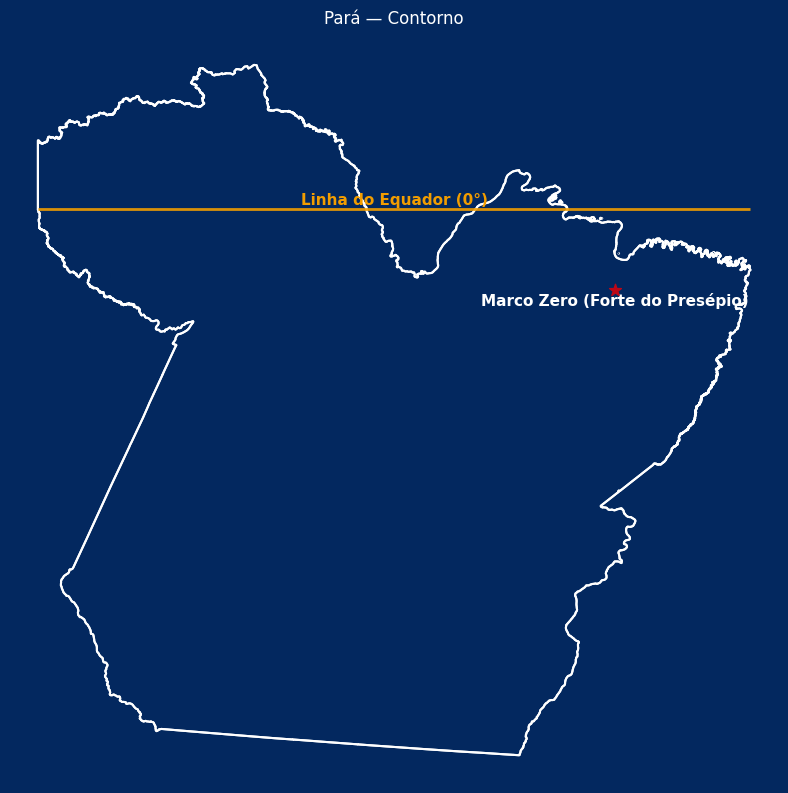

In [0]:
# ====== Mapa do Pará: outline/choropleth + Equador + Marco Zero ======
# Requisitos:
#   pip install geopandas shapely geobr matplotlib
# Observação: 'geobr' baixa os shapes oficiais do IBGE (internet necessária na 1ª vez).

import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import LineString, Point
import warnings

# ---------- Parâmetros de visual ----------
MODE = "outline"         # "outline" ou "choropleth"
YEAR = 2020              # ano do shape do geobr
FACE_BG = "#03285F"
EDGE_COLOR = "white"
FILL_COLOR = "#0B3A7E"
CHORO_CMAP = "YlOrRd"    # colormap para coroplético
EQ_COLOR = "#F29D00"     # cor da Linha do Equador
STAR_COLOR = "#BD0717"   # cor da estrela do Marco Zero

# ---------- Coordenadas do Marco Zero (Forte do Presépio), Belém ----------
# Fonte (DMS -> decimal):
#   1° 27' 15.902" S, 48° 30' 19.026" O  ->  (-1.454417, -48.505285)
MARCOZERO_LAT = -1.454417
MARCOZERO_LON = -48.505285

# ---------- 1) Ler geometrias com geobr ----------
try:
    import geobr
except Exception as e:
    raise SystemExit(
        "Instale o pacote 'geobr' (pip install geobr) para baixar os limites oficiais do IBGE."
    )

# Estado (Pará)
gdf_pa = geobr.read_state(code_state="PA", year=YEAR, simplified=True)
# Garante CRS geodésico (lat,lon). Geobr já vem em SIRGAS 4674; só padronizando.
gdf_pa = gdf_pa.to_crs(4326)

# Municípios (para coroplético)
if MODE == "choropleth":
    gdf_muni = geobr.read_municipality(code_muni="PA", year=YEAR, simplified=True).to_crs(4326)

# ---------- 2) Construir linha do Equador se cruzar o estado ----------
minx, miny, maxx, maxy = gdf_pa.total_bounds
equator_line = None
if miny <= 0.0 <= maxy:
    # Linha do Equador atravessando o bbox do estado
    equator_line = LineString([(minx, 0.0), (maxx, 0.0)])

# ---------- 3) Ponto do Marco Zero ----------
marcozero_pt = Point(MARCOZERO_LON, MARCOZERO_LAT)

# ---------- 4) Plot ----------
fig, ax = plt.subplots(figsize=(8, 8))
fig.patch.set_facecolor(FACE_BG)
ax.set_facecolor(FACE_BG)

# (a) Outline ou choropleth
if MODE == "outline":
    gdf_pa.boundary.plot(ax=ax, color=EDGE_COLOR, linewidth=1.5)
    gdf_pa.plot(ax=ax, color="none", edgecolor=EDGE_COLOR, linewidth=1.5)
else:
    # Exemplo de coroplético “dummy”: pinta por área (só pra demonstrar).
    # Se você tiver um DataFrame com métrica por município (coluna 'code_muni'),
    # basta fazer um merge e plotar por essa coluna.
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        gdf_muni["__area_deg2"] = gdf_muni.geometry.area  # área em graus² (apenas demonstrativo)
    gdf_muni.plot(
        ax=ax, column="__area_deg2", cmap=CHORO_CMAP,
        linewidth=0.4, edgecolor=EDGE_COLOR, legend=False
    )
    # contorno do estado por cima
    gdf_pa.boundary.plot(ax=ax, color=EDGE_COLOR, linewidth=1.5)

# (b) Linha do Equador (se existir no bbox)
if equator_line is not None:
    gpd.GeoSeries([equator_line], crs=4326).plot(ax=ax, color=EQ_COLOR, linewidth=2, alpha=0.9, zorder=3)
    ax.text(
        (minx + maxx) / 2, 0.02, "Linha do Equador (0°)",
        color=EQ_COLOR, ha="center", va="bottom", fontsize=11, fontweight="bold"
    )

# (c) Marco Zero: estrela + rótulo
gpd.GeoSeries([marcozero_pt], crs=4326).plot(
    ax=ax, color=STAR_COLOR, markersize=80, marker="*", zorder=5
)
ax.text(
    MARCOZERO_LON, MARCOZERO_LAT - 0.05,
    "Marco Zero (Forte do Presépio)",
    color="white", ha="center", va="top", fontsize=11, fontweight="bold"
)

# ---------- 5) Acabamento ----------
# Limites e eixos
ax.set_xlim(minx - 0.5, maxx + 0.5)
ax.set_ylim(miny - 0.5, maxy + 0.5)
ax.set_xlabel(""); ax.set_ylabel("")
ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for spine in ax.spines.values():
    spine.set_visible(False)
plt.title(f"Pará — {('Contorno' if MODE=='outline' else 'Coroplético por município')}", color="white", pad=10)
plt.tight_layout()
plt.show()


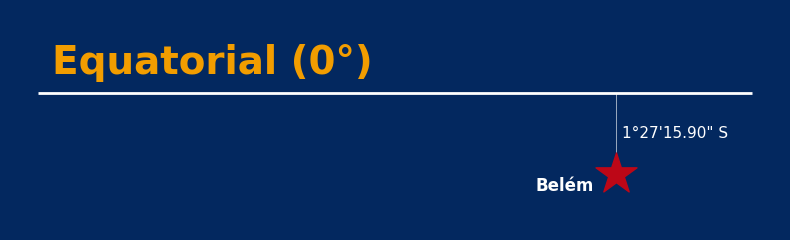

In [0]:
# ====== Equador (branco) + Belém com linha perpendicular e rótulos configuráveis ======
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import LineString, Point

# ---------- Parâmetros visuais ----------
FACE_BG          = "#03285F"
EQ_LINE_COLOR    = "white"   # cor da linha do Equador
EQ_TEXT_COLOR    = "#F29D00"   # cor do texto do rótulo do Equador
STAR_COLOR       = "#BD0717" # cor da estrela (Belém)
AUX_LINE_COLOR   = "white"   # cor da linha perpendicular
AUX_LINE_WIDTH   = 0.6       # espessura da perpendicular
YEAR             = 2020

# ---------- Texto e tamanhos (fáceis de ajustar) ----------
EQUATOR_LABEL_TEXT      = "Equatorial (0°)"  # texto do rótulo do Equador
EQUATOR_LABEL_FONTSIZE  = 28                       # tamanho rótulo Equador
STAR_LABEL_TEXT         = "Belém"                  # texto do rótulo da estrela
STAR_LABEL_FONTSIZE     = 12                       # tamanho rótulo da estrela
DMS_LABEL_FONTSIZE      = 11                       # tamanho rótulo da linha perpendicular

# offsets do rótulo do Equador (fração do span em X e deslocamento fixo em Y, em graus)
EQ_LABEL_X_OFFSET_FRAC  = 0.02    # ~2% do span em X para “sair” da borda esquerda
EQ_LABEL_Y_OFFSET       = 0.2    # deslocamento em graus acima da linha (0°)

# deslocamento do rótulo “Belém” (para a esquerda da estrela)
STAR_LABEL_X_OFFSET     = 0.40    # graus de longitude
STAR_LABEL_Y_OFFSET     = 0.05    # graus de latitude (para baixo da estrela)

# ---------- Marco Zero (Belém) ----------
MARCOZERO_LAT = -1.454417
MARCOZERO_LON = -48.505285

# ---------- Util: converter decimal -> DMS (graus, minutos, segundos) ----------
def dec_to_dms_lat(dec_lat: float) -> str:
    s = "S" if dec_lat < 0 else "N"
    v = abs(dec_lat)
    deg = int(v)
    minutes_full = (v - deg) * 60
    minutes = int(minutes_full)
    seconds = (minutes_full - minutes) * 60
    return f"{deg}°{minutes:02d}'{seconds:05.2f}\" {s}"

# ---------- 1) Usar geobr apenas para definir o comprimento em X ----------
import geobr
gdf_pa = geobr.read_state(code_state="PA", year=YEAR, simplified=True).to_crs(4326)
minx, _, maxx, _ = gdf_pa.total_bounds

# Se preferir não depender do geobr, comente as 2 linhas acima e use:
# span_x = 6
# minx = MARCOZERO_LON - span_x
# maxx = MARCOZERO_LON + span_x

# ---------- 2) Geometrias ----------
equator_line = LineString([(minx, 0.0), (maxx, 0.0)])
marcozero_pt = Point(MARCOZERO_LON, MARCOZERO_LAT)

# ---------- 3) Plot ----------
fig, ax = plt.subplots(figsize=(8, 6))
fig.patch.set_facecolor(FACE_BG)
ax.set_facecolor(FACE_BG)

# (a) Linha do Equador (branca)
gpd.GeoSeries([equator_line], crs=4326).plot(ax=ax, color=EQ_LINE_COLOR, linewidth=2, zorder=3)

# Rótulo do Equador à esquerda
span_x = maxx - minx
eq_label_x = minx + span_x * EQ_LABEL_X_OFFSET_FRAC
eq_label_y = 0.0 + EQ_LABEL_Y_OFFSET
ax.text(eq_label_x, eq_label_y, EQUATOR_LABEL_TEXT,
        color=EQ_TEXT_COLOR, ha="left", va="bottom",
        fontsize=EQUATOR_LABEL_FONTSIZE, fontweight="bold", zorder=4)

# (b) Estrela em Belém
gpd.GeoSeries([marcozero_pt], crs=4326).plot(
    ax=ax, color=STAR_COLOR, markersize=960, marker="*", zorder=5
)

# Rótulo “Belém” alinhado à esquerda da estrela (texto do lado esquerdo)
ax.text(MARCOZERO_LON - STAR_LABEL_X_OFFSET, MARCOZERO_LAT - STAR_LABEL_Y_OFFSET,
        STAR_LABEL_TEXT, color="white", ha="right", va="top",
        fontsize=STAR_LABEL_FONTSIZE, fontweight="bold", zorder=6)

# (c) Linha perpendicular fina do Equador até a estrela + rótulo DMS
ax.plot([MARCOZERO_LON, MARCOZERO_LON], [0.0, MARCOZERO_LAT],
        color=AUX_LINE_COLOR, linewidth=AUX_LINE_WIDTH, alpha=0.7, zorder=4)

dms_text = f"{dec_to_dms_lat(MARCOZERO_LAT)}"
# Posiciona o rótulo no meio da perpendicular, ligeiro deslocamento para a direita
mid_y = (MARCOZERO_LAT + 0.0) / 2
ax.text(MARCOZERO_LON + 0.10, mid_y,
        dms_text, color="white", ha="left", va="center",
        fontsize=DMS_LABEL_FONTSIZE, zorder=6)

# ---------- 4) Enquadramento apertado ----------
PAD_UP   = 1.5  # espaço acima de 0°
PAD_DOWN = 1  # espaço abaixo de Belém
ymin = min(MARCOZERO_LAT, 0.0) - PAD_DOWN
ymax = max(MARCOZERO_LAT, 0.0) + PAD_UP
ax.set_ylim(ymin, ymax)

ax.set_xlim(minx - 0.5, maxx + 0.5)

# ---------- 5) Limpeza ----------
ax.set_xlabel(""); ax.set_ylabel("")
ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for s in ax.spines.values():
    s.set_visible(False)

# (Sem título)
plt.tight_layout()
plt.show()


### Quente

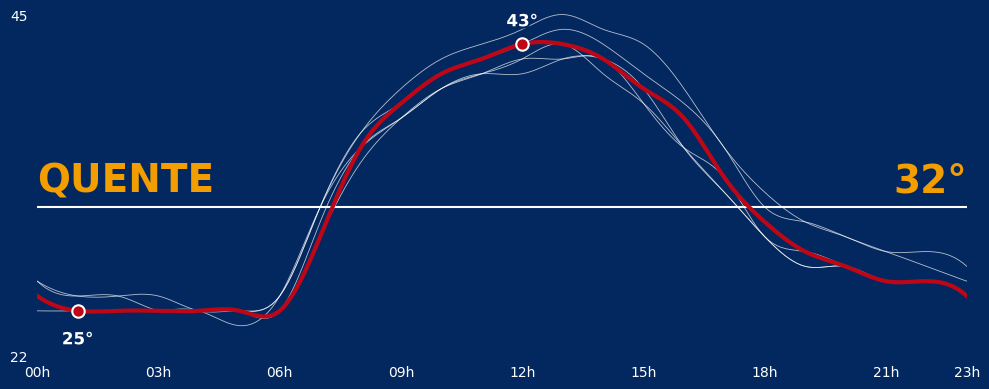

In [0]:
# --- imports ---
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import matplotlib.font_manager as fm
import matplotlib.patheffects as pe
from scipy.interpolate import make_interp_spline  # usado no smoothing

# =========== INPUT ===========
# expects a DataFrame named pandas_df with columns:
# ano, hora_medicao_prev_hora, hora, anomes, sensacao_termica_max_c
df = pandas_df.copy()

# --------- prep: numeric types + one point per (ano,hora) ----------
df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")
df = df.dropna(subset=["hora", "sensacao_termica_max_c", "ano"])

# Aggregate in case there are multiple rows per hour (e.g., by anomes)
df_hour = (
    df.groupby(["ano", "hora"], as_index=False)["sensacao_termica_max_c"]
      .mean()
      .sort_values(["ano", "hora"])
)

# --------- smoothing helper ----------
def smooth_xy(x, y, step=0.1):
    """
    Given x (e.g., hours 0..23) and y, return a densely sampled (xs, ys).
    Uses cubic spline (SciPy).
    """
    x = np.asarray(x, dtype=float)
    y = np.asarray(y, dtype=float)

    # ensure strictly increasing x with unique values
    uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
    xu = uniq["x"].values
    yu = uniq["y"].values

    if len(xu) < 2:
        return xu, yu

    xs = np.arange(xu.min(), xu.max() + 1e-9, step)
    spl = make_interp_spline(xu, yu, k=3)
    ys = spl(xs)
    return xs, ys

# --------- plot ----------
fig, ax = plt.subplots(figsize=(10, 4))
fig.patch.set_facecolor("#03285F")
ax.set_facecolor("#03285F")

# plot all years except 2025 (thin white, smoothed)
for a in sorted(df_hour["ano"].unique()):
    if a == 2025:
        continue
    sub = df_hour[df_hour["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub["sensacao_termica_max_c"].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax, color="white", linewidth=0.6, alpha=0.7, legend=False)

# plot 2025 (thick highlight color, smoothed)
if (df_hour["ano"] == 2025).any():
    sub25 = df_hour[df_hour["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25["sensacao_termica_max_c"].values, step=0.1)
    sns.lineplot(x=xs25, y=ys25, ax=ax, color="#BD0717", linewidth=3, legend=False, zorder=3)

    # ---- pontos e rótulos: MAX e MIN de 2025 (usando os pontos reais por hora) ----
    idx_max = sub25["sensacao_termica_max_c"].idxmax()
    idx_min = sub25["sensacao_termica_max_c"].idxmin()
    row_max = sub25.loc[idx_max]
    row_min = sub25.loc[idx_min]

    # ponto circular para o máximo
    ax.scatter(
        row_max["hora"], row_max["sensacao_termica_max_c"],
        s=80, facecolors="#BD0717", edgecolors="white", linewidths=1.5, zorder=4
    )
    ax.annotate(
        f'{int(round(row_max["sensacao_termica_max_c"]))}°',
        xy=(row_max["hora"], row_max["sensacao_termica_max_c"]),
        xytext=(0, 10), textcoords="offset points",
        ha="center", va="bottom",
        color="white", fontsize=12, fontweight="bold",
        path_effects=[pe.withStroke(linewidth=3, foreground="#03285F")]
    )

    # ponto circular para o mínimo
    ax.scatter(
        row_min["hora"], row_min["sensacao_termica_max_c"],
        s=80, facecolors="#BD0717", edgecolors="white", linewidths=1.5, zorder=4
    )
    ax.annotate(
        f'{int(round(row_min["sensacao_termica_max_c"]))}°',
        xy=(row_min["hora"], row_min["sensacao_termica_max_c"]),
        xytext=(0, -14), textcoords="offset points",
        ha="center", va="top",
        color="white", fontsize=12, fontweight="bold",
        path_effects=[pe.withStroke(linewidth=3, foreground="#03285F")]
    )

# --- ticks/labels on X every 3h (include 23h) ---
ticks_3h = list(range(0, 24, 3))
if 23 not in ticks_3h:
    ticks_3h.append(23)
labels_3h = [f"{h:02d}h" for h in ticks_3h]
ax.set_xlim(0, 23)
ax.set_xticks(ticks_3h)
ax.set_xticklabels(labels_3h, rotation=0, color="white")

# --- Y axis & reference line ---
ax.set_ylim(22, 45)
ax.set_yticks([22, 45])
ax.set_yticklabels(["22", "45"], color="white")
ax.axhline(y=32, color="white", linewidth=1.5, zorder=0)

# labels on the 32 line
ax.text(0, 32.5, "QUENTE", va="bottom", ha="left", fontsize=28,
        color="#F29D00", fontweight="bold")
ax.text(23, 32.5, "32°", va="bottom", ha="right", fontsize=28,
        color="#F29D00", fontweight="bold")

# cosmetics
ax.set_xlabel("")
ax.set_ylabel("")
ax.grid(False)
sns.despine(ax=ax, left=True, bottom=True)
ax.tick_params(left=False, bottom=False)

plt.tight_layout()
plt.show()


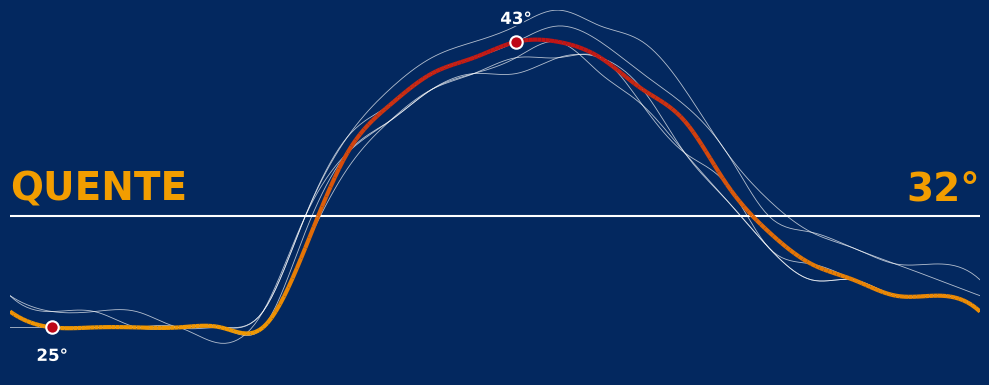

In [0]:
# --- imports ---
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import LinearSegmentedColormap, Normalize
import matplotlib.patheffects as pe
from scipy.interpolate import make_interp_spline  # usado no smoothing

# =========== INPUT ===========
# espera um DataFrame pandas_df com colunas:
# ano, hora_medicao_prev_hora, hora, anomes, sensacao_termica_max_c
df = pandas_df.copy()

# --------- prep: numeric types + limpeza ----------
df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")
df = df.dropna(subset=["hora", "sensacao_termica_max_c", "ano"])

# Agregação: um ponto por (ano, hora)
df_hour = (
    df.groupby(["ano", "hora"], as_index=False)["sensacao_termica_max_c"]
      .mean()
      .sort_values(["ano", "hora"])
)

# --------- smoothing helper ----------
def smooth_xy(x, y, step=0.1):
    """Retorna (xs, ys) densos via spline cúbica."""
    x = np.asarray(x, dtype=float)
    y = np.asarray(y, dtype=float)
    uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
    xu = uniq["x"].values
    yu = uniq["y"].values
    if len(xu) < 2:
        return xu, yu
    xs = np.arange(xu.min(), xu.max() + 1e-9, step)
    ys = make_interp_spline(xu, yu, k=3)(xs)
    return xs, ys

# --------- gradiente (cores e normalização) ----------
COLOR_LOW  = "#F29D00"   # Y mais baixo
COLOR_HIGH = "#BD0717"   # Y mais alto
cmap = LinearSegmentedColormap.from_list("temp_grad", [COLOR_LOW, COLOR_HIGH])

# faixa de normalização pela série toda (deixe fixo para estabilidade visual)
y_all = df_hour["sensacao_termica_max_c"].values
norm = Normalize(vmin=float(np.nanmin(y_all)), vmax=float(np.nanmax(y_all)))

# --------- plot ----------
fig, ax = plt.subplots(figsize=(10, 4))
fig.patch.set_facecolor("#03285F")
ax.set_facecolor("#03285F")

# anos exceto 2025 (linhas brancas finas, suavizadas)
for a in sorted(df_hour["ano"].unique()):
    if a == 2025:
        continue
    sub = df_hour[df_hour["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub["sensacao_termica_max_c"].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax, color="white", linewidth=0.6, alpha=0.7, legend=False)

# 2025 com GRADIENTE
if (df_hour["ano"] == 2025).any():
    sub25 = df_hour[df_hour["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25["sensacao_termica_max_c"].values, step=0.1)

    # segmentos para LineCollection
    points = np.array([xs25, ys25]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    ys_mid = (ys25[:-1] + ys25[1:]) / 2.0

    lc = LineCollection(segments, cmap=cmap, norm=norm, linewidth=3, zorder=3)
    lc.set_array(ys_mid)
    ax.add_collection(lc)

    # pontos reais para rótulos de máximo e mínimo
    idx_max = sub25["sensacao_termica_max_c"].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25["sensacao_termica_max_c"].idxmin(); row_min = sub25.loc[idx_min]

    ax.scatter(row_max["hora"], row_max["sensacao_termica_max_c"],
               s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax.annotate(f'{int(round(row_max["sensacao_termica_max_c"]))}°',
                xy=(row_max["hora"], row_max["sensacao_termica_max_c"]),
                xytext=(0, 10), textcoords="offset points",
                ha="center", va="bottom", color="white", fontsize=12, fontweight="bold",
                path_effects=[pe.withStroke(linewidth=3, foreground="#03285F")])

    ax.scatter(row_min["hora"], row_min["sensacao_termica_max_c"],
               s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax.annotate(f'{int(round(row_min["sensacao_termica_max_c"]))}°',
                xy=(row_min["hora"], row_min["sensacao_termica_max_c"]),
                xytext=(0, -14), textcoords="offset points",
                ha="center", va="top", color="white", fontsize=12, fontweight="bold",
                path_effects=[pe.withStroke(linewidth=3, foreground="#03285F")])

# limites e estética
ax.set_xlim(0, 23)

# defina Y como antes (ajuste se quiser)
ax.set_ylim(22, 45)

# ---- REMOVER rótulos e ticks de X e Y ----
ax.set_xticks([])  # remove ticks do X
ax.set_yticks([])  # remove ticks do Y
ax.tick_params(left=False, bottom=False)

# linha de referência em 32°
ax.axhline(y=32, color="white", linewidth=1.5, zorder=0)

# textos na linha de 32°
ax.text(0, 32.5, "QUENTE", va="bottom", ha="left", fontsize=28,
        color="#F29D00", fontweight="bold")
ax.text(23, 32.5, "32°", va="bottom", ha="right", fontsize=28,
        color="#F29D00", fontweight="bold")

# limpeza final
ax.set_xlabel(""); ax.set_ylabel("")
ax.grid(False)
sns.despine(ax=ax, left=True, bottom=True)

plt.tight_layout()
plt.show()


### Umido

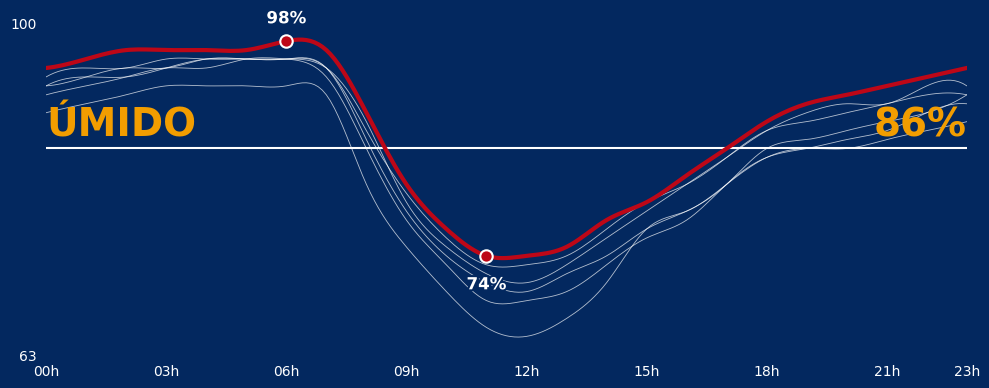

In [0]:
# --- imports ---
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import matplotlib.font_manager as fm
import matplotlib.patheffects as pe
from scipy.interpolate import make_interp_spline  # usado no smoothing

# ================== PARÂMETROS ==================
METRIC = "umidade_rel_max_prev_hora_pct"  # métrica a plotar
REF_Y  = 86                                # linha de referência (86%)
REF_LABEL_LEFT  = "ÚMIDO"
REF_LABEL_RIGHT = "86%"

# =========== INPUT ===========
# espera um DataFrame pandas_df com colunas:
# ano, hora_medicao_prev_hora, hora, anomes, sensacao_termica_max_c, umidade_rel_max_prev_hora_pct
df = pandas_df.copy()

# --------- prep: tipos + limpeza ----------
df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")
df = df.dropna(subset=["hora", METRIC, "ano"])

# Agregação: um ponto por (ano, hora) na métrica de umidade
df_hour = (
    df.groupby(["ano", "hora"], as_index=False)[METRIC]
      .mean()
      .sort_values(["ano", "hora"])
)

# --------- smoothing helper ----------
def smooth_xy(x, y, step=0.1):
    """
    Dado x (e.g., 0..23) e y, retorna (xs, ys) densos.
    Usa cubic spline (SciPy).
    """
    x = np.asarray(x, dtype=float)
    y = np.asarray(y, dtype=float)

    uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
    xu = uniq["x"].values
    yu = uniq["y"].values
    if len(xu) < 2:
        return xu, yu

    xs = np.arange(xu.min(), xu.max() + 1e-9, step)
    ys = make_interp_spline(xu, yu, k=3)(xs)
    return xs, ys

# --------- plot ----------
fig, ax = plt.subplots(figsize=(10, 4))
fig.patch.set_facecolor("#03285F")
ax.set_facecolor("#03285F")

# --- linhas suavizadas: anos exceto 2025 (brancas, finas) ---
for a in sorted(df_hour["ano"].unique()):
    if a == 2025:
        continue
    sub = df_hour[df_hour["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub[METRIC].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax, color="white", linewidth=0.6, alpha=0.7, legend=False)

# --- linha suavizada: 2025 (vermelha, espessa) + marcadores de máx/mín ---
if (df_hour["ano"] == 2025).any():
    sub25 = df_hour[df_hour["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25[METRIC].values, step=0.1)
    sns.lineplot(x=xs25, y=ys25, ax=ax, color="#BD0717", linewidth=3, legend=False, zorder=3)

    # Pontos reais (sem suavização) para localizar máx/mín de 2025
    idx_max = sub25[METRIC].idxmax()
    idx_min = sub25[METRIC].idxmin()
    row_max = sub25.loc[idx_max]
    row_min = sub25.loc[idx_min]

    # ponto circular para o MÁXIMO
    ax.scatter(
        row_max["hora"], row_max[METRIC],
        s=80, facecolors="#BD0717", edgecolors="white", linewidths=1.5, zorder=4
    )
    ax.annotate(
        f'{int(round(row_max[METRIC]))}%',
        xy=(row_max["hora"], row_max[METRIC]),
        xytext=(0, 10), textcoords="offset points",
        ha="center", va="bottom",
        color="white", fontsize=12, fontweight="bold",
        path_effects=[pe.withStroke(linewidth=3, foreground="#03285F")]
    )

    # ponto circular para o MÍNIMO
    ax.scatter(
        row_min["hora"], row_min[METRIC],
        s=80, facecolors="#BD0717", edgecolors="white", linewidths=1.5, zorder=4
    )
    ax.annotate(
        f'{int(round(row_min[METRIC]))}%',
        xy=(row_min["hora"], row_min[METRIC]),
        xytext=(0, -14), textcoords="offset points",
        ha="center", va="top",
        color="white", fontsize=12, fontweight="bold",
        path_effects=[pe.withStroke(linewidth=3, foreground="#03285F")]
    )

# --- ticks/labels no X a cada 3h + 23h ---
ticks_3h = list(range(0, 24, 3))
if 23 not in ticks_3h:
    ticks_3h.append(23)
labels_3h = [f"{h:02d}h" for h in ticks_3h]
ax.set_xlim(0, 23)
ax.set_xticks(ticks_3h)
ax.set_xticklabels(labels_3h, rotation=0, color="white")

# --- eixo Y e linha de referência (86%) ---
# define limites dinamicamente com margem e garantindo que 86 esteja visível
y_vals = df_hour[METRIC].values
y_min = float(np.nanmin(y_vals)) if len(y_vals) else 0
y_max = float(np.nanmax(y_vals)) if len(y_vals) else 100
pad = max(2, 0.05 * (y_max - y_min if y_max > y_min else 10))
ax.set_ylim(min(y_min - pad, REF_Y - 2), max(y_max + pad, REF_Y + 2))

# ticks mínimos (extremos) para manter visual limpo
ax.set_yticks([round(ax.get_ylim()[0]), round(ax.get_ylim()[1])])
ax.set_yticklabels([f"{int(ax.get_ylim()[0])}", f"{int(ax.get_ylim()[1])}"], color="white")

# linha de referência em 86%
ax.axhline(y=REF_Y, color="white", linewidth=1.5, zorder=0)

# rótulos na linha de 86%
ax.text(0, REF_Y + 0.5, REF_LABEL_LEFT, va="bottom", ha="left", fontsize=28,
        color="#F29D00", fontweight="bold")
ax.text(23, REF_Y + 0.5, REF_LABEL_RIGHT, va="bottom", ha="right", fontsize=28,
        color="#F29D00", fontweight="bold")

# estética
ax.set_xlabel("")
ax.set_ylabel("")
ax.grid(False)
sns.despine(ax=ax, left=True, bottom=True)
ax.tick_params(left=False, bottom=False)

plt.tight_layout()
plt.show()


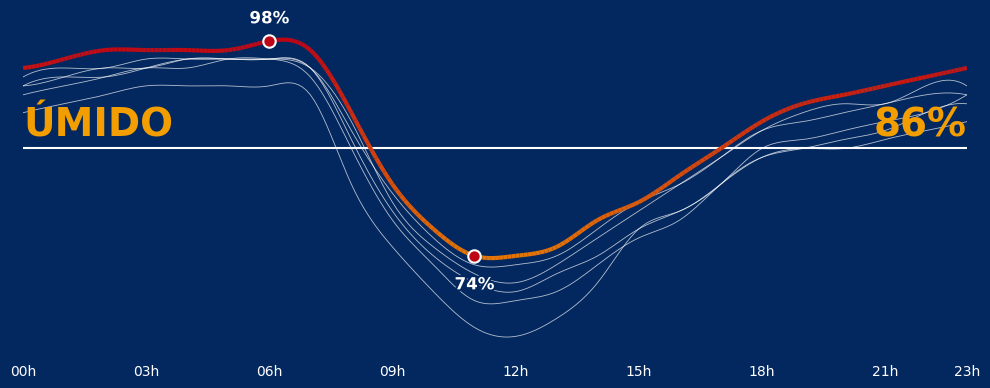

In [0]:
# --- imports ---
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import LinearSegmentedColormap, Normalize
import matplotlib.patheffects as pe
from scipy.interpolate import make_interp_spline  # usado no smoothing

# ================== PARÂMETROS ==================
METRIC = "umidade_rel_max_prev_hora_pct"  # métrica a plotar
REF_Y  = 86                                # linha de referência (86%)
REF_LABEL_LEFT  = "ÚMIDO"
REF_LABEL_RIGHT = "86%"

# =========== INPUT ===========
# espera um DataFrame pandas_df com colunas:
# ano, hora_medicao_prev_hora, hora, anomes, sensacao_termica_max_c, umidade_rel_max_prev_hora_pct
df = pandas_df.copy()

# --------- prep: tipos + limpeza ----------
df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")
df = df.dropna(subset=["hora", METRIC, "ano"])

# Agregação: um ponto por (ano, hora) na métrica de umidade
df_hour = (
    df.groupby(["ano", "hora"], as_index=False)[METRIC]
      .mean()
      .sort_values(["ano", "hora"])
)

# --------- smoothing helper ----------
def smooth_xy(x, y, step=0.1):
    """Dado x (e.g., 0..23) e y, retorna (xs, ys) densos usando cubic spline."""
    x = np.asarray(x, dtype=float)
    y = np.asarray(y, dtype=float)
    uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
    xu = uniq["x"].values
    yu = uniq["y"].values
    if len(xu) < 2:
        return xu, yu
    xs = np.arange(xu.min(), xu.max() + 1e-9, step)
    ys = make_interp_spline(xu, yu, k=3)(xs)
    return xs, ys

# --------- gradiente (cores e normalização) ----------
COLOR_LOW  = "#F29D00"   # cor para Y mais baixo
COLOR_HIGH = "#BD0717"   # cor para Y mais alto
cmap = LinearSegmentedColormap.from_list("humid_grad", [COLOR_LOW, COLOR_HIGH])

# normalização baseada na faixa real dos dados (antes de desenhar)
y_vals_all = df_hour[METRIC].values
y_min_all = float(np.nanmin(y_vals_all)) if len(y_vals_all) else 0.0
y_max_all = float(np.nanmax(y_vals_all)) if len(y_vals_all) else 100.0
norm = Normalize(vmin=y_min_all, vmax=y_max_all)

# --------- plot ----------
fig, ax = plt.subplots(figsize=(10, 4))
fig.patch.set_facecolor("#03285F")
ax.set_facecolor("#03285F")

# --- linhas suavizadas: anos exceto 2025 (brancas, finas) ---
for a in sorted(df_hour["ano"].unique()):
    if a == 2025:
        continue
    sub = df_hour[df_hour["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub[METRIC].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax, color="white", linewidth=0.6, alpha=0.7, legend=False)

# --- linha suavizada: 2025 com GRADIENTE por Y + marcadores de máx/mín ---
if (df_hour["ano"] == 2025).any():
    sub25 = df_hour[df_hour["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25[METRIC].values, step=0.1)

    # construir segmentos (x_i,y_i) -> (x_{i+1},y_{i+1})
    points = np.array([xs25, ys25]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    ys_mid = (ys25[:-1] + ys25[1:]) / 2.0  # valor para colorir cada segmento

    lc = LineCollection(segments, cmap=cmap, norm=norm, linewidth=3, zorder=3)
    lc.set_array(ys_mid)
    ax.add_collection(lc)

    # Pontos reais (sem suavização) para localizar máx/mín de 2025
    idx_max = sub25[METRIC].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25[METRIC].idxmin(); row_min = sub25.loc[idx_min]

    ax.scatter(
        row_max["hora"], row_max[METRIC],
        s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4
    )
    ax.annotate(
        f'{int(round(row_max[METRIC]))}%',
        xy=(row_max["hora"], row_max[METRIC]),
        xytext=(0, 10), textcoords="offset points",
        ha="center", va="bottom",
        color="white", fontsize=12, fontweight="bold",
        path_effects=[pe.withStroke(linewidth=3, foreground="#03285F")]
    )

    ax.scatter(
        row_min["hora"], row_min[METRIC],
        s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4
    )
    ax.annotate(
        f'{int(round(row_min[METRIC]))}%',
        xy=(row_min["hora"], row_min[METRIC]),
        xytext=(0, -14), textcoords="offset points",
        ha="center", va="top",
        color="white", fontsize=12, fontweight="bold",
        path_effects=[pe.withStroke(linewidth=3, foreground="#03285F")]
    )

# --- ticks/labels no X a cada 3h + 23h ---
ticks_3h = list(range(0, 24, 3))
if 23 not in ticks_3h: ticks_3h.append(23)
labels_3h = [f"{h:02d}h" for h in ticks_3h]
ax.set_xlim(0, 23)
ax.set_xticks(ticks_3h)
ax.set_xticklabels(labels_3h, rotation=0, color="white")

# --- eixo Y e linha de referência (86%) ---
pad = max(2, 0.05 * (y_max_all - y_min_all if y_max_all > y_min_all else 10))
ax.set_ylim(min(y_min_all - pad, REF_Y - 2), max(y_max_all + pad, REF_Y + 2))

# ---- REMOVER APENAS OS LABELS DO EIXO Y ----
ax.tick_params(axis="y", labelleft=False)  # esconde labels do Y (mantém a escala)
# (se quiser também esconder as marcas/ticks do Y: ax.tick_params(axis="y", left=False))

# linha de referência em 86%
ax.axhline(y=REF_Y, color="white", linewidth=1.5, zorder=0)

# rótulos na linha de 86%
ax.text(0,   REF_Y + 0.5, REF_LABEL_LEFT,  va="bottom", ha="left",  fontsize=28,
        color="#F29D00", fontweight="bold")
ax.text(23,  REF_Y + 0.5, REF_LABEL_RIGHT, va="bottom", ha="right", fontsize=28,
        color="#F29D00", fontweight="bold")

# estética
ax.set_xlabel(""); ax.set_ylabel("")
ax.grid(False)
sns.despine(ax=ax, left=True, bottom=True)
ax.tick_params(left=False, bottom=False)

plt.tight_layout()
plt.show()


### Conjunto

/home/spark-8d53e2df-57a6-445a-9661-0d/.ipykernel/3814/command-5031745298785648-4125134747:299: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.03, 0.03, 0.97, 0.96])  # deixa espaço p/ o suptitle


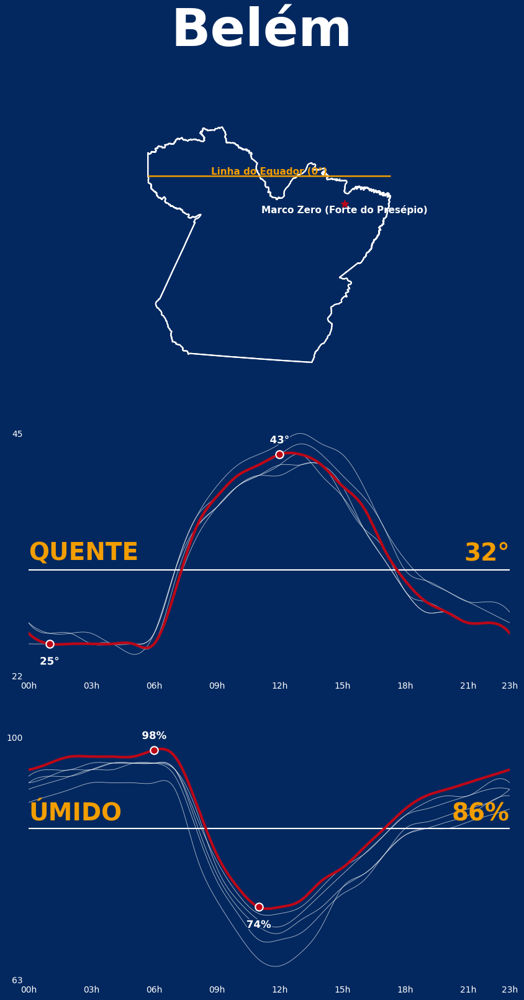

In [0]:
# ===============================================
# "Belém" grande + 3 gráficos empilhados (1 coluna)
# ===============================================
# Requisitos (conforme seus códigos):
#   pip install geopandas shapely geobr matplotlib seaborn scipy
#   (geobr baixa os shapes na 1ª vez em que roda)

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patheffects as pe
from matplotlib.lines import Line2D
from scipy.interpolate import make_interp_spline
import geopandas as gpd
from shapely.geometry import LineString, Point
import warnings

# ---------- Paleta/cores de fundo ----------
FACE_BG = "#03285F"
EDGE_COLOR = "white"

# =========================================================
# 1) FUNÇÃO: Gráfico 1 (Mapa do Pará com Linha do Equador)
# =========================================================
def plot_mapa_para(ax, mode="outline", year=2020,
                   edge_color="white", fill_color="#0B3A7E",
                   choro_cmap="YlOrRd", eq_color="#F29D00",
                   star_color="#BD0717"):
    import geobr  # importa aqui para evitar erro se ambiente não tiver

    # Estado (Pará)
    gdf_pa = geobr.read_state(code_state="PA", year=year, simplified=True).to_crs(4326)

    # Municípios (se for choropleth)
    if mode == "choropleth":
        gdf_muni = geobr.read_municipality(code_muni="PA", year=year, simplified=True).to_crs(4326)

    # Marco Zero (Forte do Presépio)
    MARCOZERO_LAT = -1.454417
    MARCOZERO_LON = -48.505285
    marcozero_pt = Point(MARCOZERO_LON, MARCOZERO_LAT)

    # Linha do Equador (se cruzar bbox)
    minx, miny, maxx, maxy = gdf_pa.total_bounds
    equator_line = None
    if miny <= 0.0 <= maxy:
        equator_line = LineString([(minx, 0.0), (maxx, 0.0)])

    # Fundo
    ax.set_facecolor(FACE_BG)

    # Outline / Choropleth
    if mode == "outline":
        gdf_pa.boundary.plot(ax=ax, color=edge_color, linewidth=1.5)
        gdf_pa.plot(ax=ax, color="none", edgecolor=edge_color, linewidth=1.5)
    else:
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            gdf_muni["__area_deg2"] = gdf_muni.geometry.area
        gdf_muni.plot(
            ax=ax, column="__area_deg2", cmap=choro_cmap,
            linewidth=0.4, edgecolor=edge_color, legend=False
        )
        gdf_pa.boundary.plot(ax=ax, color=edge_color, linewidth=1.5)

    # Equador
    if equator_line is not None:
        gpd.GeoSeries([equator_line], crs=4326).plot(ax=ax, color=eq_color, linewidth=2, alpha=0.9, zorder=3)
        ax.text((minx + maxx) / 2, 0.02, "Linha do Equador (0°)",
                color=eq_color, ha="center", va="bottom", fontsize=11, fontweight="bold")

    # Marco Zero
    gpd.GeoSeries([marcozero_pt], crs=4326).plot(ax=ax, color=star_color, markersize=80, marker="*", zorder=5)
    ax.text(MARCOZERO_LON, MARCOZERO_LAT - 0.05,
            "Marco Zero (Forte do Presépio)",
            color="white", ha="center", va="top", fontsize=11, fontweight="bold")

    # Limites & limpeza
    ax.set_xlim(minx - 0.5, maxx + 0.5)
    ax.set_ylim(miny - 0.5, maxy + 0.5)
    ax.set_aspect("equal")
    ax.set_xlabel(""); ax.set_ylabel("")
    ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
    for spine in ax.spines.values():
        spine.set_visible(False)

# =========================================================
# 2) FUNÇÃO: Gráfico 2 (Sensação térmica suavizada)
# =========================================================
def plot_temp(ax, pandas_df):
    df = pandas_df.copy()
    df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
    df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")
    df = df.dropna(subset=["hora", "sensacao_termica_max_c", "ano"])

    df_hour = (
        df.groupby(["ano", "hora"], as_index=False)["sensacao_termica_max_c"]
          .mean()
          .sort_values(["ano", "hora"])
    )

    def smooth_xy(x, y, step=0.1):
        x = np.asarray(x, dtype=float)
        y = np.asarray(y, dtype=float)
        uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
        xu, yu = uniq["x"].values, uniq["y"].values
        if len(xu) < 2:
            return xu, yu
        xs = np.arange(xu.min(), xu.max() + 1e-9, step)
        ys = make_interp_spline(xu, yu, k=3)(xs)
        return xs, ys

    ax.set_facecolor(FACE_BG)

    # Outros anos
    for a in sorted(df_hour["ano"].unique()):
        if a == 2025:
            continue
        sub = df_hour[df_hour["ano"] == a]
        xs, ys = smooth_xy(sub["hora"].values, sub["sensacao_termica_max_c"].values, step=0.1)
        sns.lineplot(x=xs, y=ys, ax=ax, color="white", linewidth=0.6, alpha=0.7, legend=False)

    # 2025
    if (df_hour["ano"] == 2025).any():
        sub25 = df_hour[df_hour["ano"] == 2025].sort_values("hora")
        xs25, ys25 = smooth_xy(sub25["hora"].values, sub25["sensacao_termica_max_c"].values, step=0.1)
        sns.lineplot(x=xs25, y=ys25, ax=ax, color="#BD0717", linewidth=3, legend=False, zorder=3)

        idx_max = sub25["sensacao_termica_max_c"].idxmax()
        idx_min = sub25["sensacao_termica_max_c"].idxmin()
        row_max = sub25.loc[idx_max]
        row_min = sub25.loc[idx_min]

        ax.scatter(row_max["hora"], row_max["sensacao_termica_max_c"],
                   s=80, facecolors="#BD0717", edgecolors="white", linewidths=1.5, zorder=4)
        ax.annotate(f'{int(round(row_max["sensacao_termica_max_c"]))}°',
                    xy=(row_max["hora"], row_max["sensacao_termica_max_c"]),
                    xytext=(0, 10), textcoords="offset points",
                    ha="center", va="bottom",
                    color="white", fontsize=12, fontweight="bold",
                    path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

        ax.scatter(row_min["hora"], row_min["sensacao_termica_max_c"],
                   s=80, facecolors="#BD0717", edgecolors="white", linewidths=1.5, zorder=4)
        ax.annotate(f'{int(round(row_min["sensacao_termica_max_c"]))}°',
                    xy=(row_min["hora"], row_min["sensacao_termica_max_c"]),
                    xytext=(0, -14), textcoords="offset points",
                    ha="center", va="top",
                    color="white", fontsize=12, fontweight="bold",
                    path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

    # Eixo X (0..23h, a cada 3h + 23h)
    ticks_3h = list(range(0, 24, 3))
    if 23 not in ticks_3h:
        ticks_3h.append(23)
    labels_3h = [f"{h:02d}h" for h in ticks_3h]
    ax.set_xlim(0, 23)
    ax.set_xticks(ticks_3h)
    ax.set_xticklabels(labels_3h, rotation=0, color="white")

    # Y + linha de referência em 32°
    ax.set_ylim(22, 45)
    ax.set_yticks([22, 45])
    ax.set_yticklabels(["22", "45"], color="white")
    ax.axhline(y=32, color="white", linewidth=1.5, zorder=0)
    ax.text(0, 32.5, "QUENTE", va="bottom", ha="left", fontsize=28,
            color="#F29D00", fontweight="bold")
    ax.text(23, 32.5, "32°", va="bottom", ha="right", fontsize=28,
            color="#F29D00", fontweight="bold")

    ax.set_xlabel(""); ax.set_ylabel("")
    ax.grid(False)
    sns.despine(ax=ax, left=True, bottom=True)
    ax.tick_params(left=False, bottom=False)

# =========================================================
# 3) FUNÇÃO: Gráfico 3 (Umidade relativa suavizada)
# =========================================================
def plot_umidade(ax, pandas_df,
                 metric="umidade_rel_max_prev_hora_pct",
                 ref_y=86, ref_label_left="ÚMIDO", ref_label_right="86%"):
    df = pandas_df.copy()
    df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
    df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")
    df = df.dropna(subset=["hora", metric, "ano"])

    df_hour = (
        df.groupby(["ano", "hora"], as_index=False)[metric]
          .mean()
          .sort_values(["ano", "hora"])
    )

    def smooth_xy(x, y, step=0.1):
        x = np.asarray(x, dtype=float)
        y = np.asarray(y, dtype=float)
        uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
        xu, yu = uniq["x"].values, uniq["y"].values
        if len(xu) < 2:
            return xu, yu
        xs = np.arange(xu.min(), xu.max() + 1e-9, step)
        ys = make_interp_spline(xu, yu, k=3)(xs)
        return xs, ys

    ax.set_facecolor(FACE_BG)

    # Outros anos
    for a in sorted(df_hour["ano"].unique()):
        if a == 2025:
            continue
        sub = df_hour[df_hour["ano"] == a]
        xs, ys = smooth_xy(sub["hora"].values, sub[metric].values, step=0.1)
        sns.lineplot(x=xs, y=ys, ax=ax, color="white", linewidth=0.6, alpha=0.7, legend=False)

    # 2025
    if (df_hour["ano"] == 2025).any():
        sub25 = df_hour[df_hour["ano"] == 2025].sort_values("hora")
        xs25, ys25 = smooth_xy(sub25["hora"].values, sub25[metric].values, step=0.1)
        sns.lineplot(x=xs25, y=ys25, ax=ax, color="#BD0717", linewidth=3, legend=False, zorder=3)

        idx_max = sub25[metric].idxmax()
        idx_min = sub25[metric].idxmin()
        row_max = sub25.loc[idx_max]
        row_min = sub25.loc[idx_min]

        ax.scatter(row_max["hora"], row_max[metric],
                   s=80, facecolors="#BD0717", edgecolors="white", linewidths=1.5, zorder=4)
        ax.annotate(f'{int(round(row_max[metric]))}%',
                    xy=(row_max["hora"], row_max[metric]),
                    xytext=(0, 10), textcoords="offset points",
                    ha="center", va="bottom",
                    color="white", fontsize=12, fontweight="bold",
                    path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

        ax.scatter(row_min["hora"], row_min[metric],
                   s=80, facecolors="#BD0717", edgecolors="white", linewidths=1.5, zorder=4)
        ax.annotate(f'{int(round(row_min[metric]))}%',
                    xy=(row_min["hora"], row_min[metric]),
                    xytext=(0, -14), textcoords="offset points",
                    ha="center", va="top",
                    color="white", fontsize=12, fontweight="bold",
                    path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

    # X
    ticks_3h = list(range(0, 24, 3))
    if 23 not in ticks_3h:
        ticks_3h.append(23)
    labels_3h = [f"{h:02d}h" for h in ticks_3h]
    ax.set_xlim(0, 23)
    ax.set_xticks(ticks_3h)
    ax.set_xticklabels(labels_3h, rotation=0, color="white")

    # Y dinâmico + linha ref
    y_vals = df_hour[metric].values
    y_min = float(np.nanmin(y_vals)) if len(y_vals) else 0
    y_max = float(np.nanmax(y_vals)) if len(y_vals) else 100
    pad = max(2, 0.05 * (y_max - y_min if y_max > y_min else 10))
    ax.set_ylim(min(y_min - pad, ref_y - 2), max(y_max + pad, ref_y + 2))

    ax.set_yticks([round(ax.get_ylim()[0]), round(ax.get_ylim()[1])])
    ax.set_yticklabels([f"{int(ax.get_ylim()[0])}", f"{int(ax.get_ylim()[1])}"], color="white")

    ax.axhline(y=ref_y, color="white", linewidth=1.5, zorder=0)
    ax.text(0, ref_y + 0.5, ref_label_left, va="bottom", ha="left", fontsize=28,
            color="#F29D00", fontweight="bold")
    ax.text(23, ref_y + 0.5, ref_label_right, va="bottom", ha="right", fontsize=28,
            color="#F29D00", fontweight="bold")

    ax.set_xlabel(""); ax.set_ylabel("")
    ax.grid(False)
    sns.despine(ax=ax, left=True, bottom=True)
    ax.tick_params(left=False, bottom=False)

# =========================================================
# 4) FIGURA ÚNICA COM 3 LINHAS (1 COLUNA)
# =========================================================
# Observação: usa 'pandas_df' já existente no ambiente.
#             ajuste figsize conforme seu layout.
fig = plt.figure(figsize=(10, 18), facecolor=FACE_BG)
gs = fig.add_gridspec(nrows=3, ncols=1, height_ratios=[1.05, 1, 1], hspace=0.25)

# Título grande "Belém"
fig.suptitle("Belém", fontsize=60, fontweight="bold", color="white", y=0.98)

# Subplots
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[1, 0])
ax3 = fig.add_subplot(gs[2, 0])

# Desenhar cada gráfico nos eixos criados
plot_mapa_para(ax1, mode="outline", year=2020)
plot_temp(ax2, pandas_df)
plot_umidade(ax3, pandas_df, metric="umidade_rel_max_prev_hora_pct",
             ref_y=86, ref_label_left="ÚMIDO", ref_label_right="86%")

# Fundo da figura
fig.patch.set_facecolor(FACE_BG)

plt.tight_layout(rect=[0.03, 0.03, 0.97, 0.96])  # deixa espaço p/ o suptitle
plt.show()


/home/spark-8d53e2df-57a6-445a-9661-0d/.ipykernel/3814/command-8276467433049193-2623270814:284: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.03, 0.02, 0.97, 0.95])  # deixa espaço superior para o "Belém"


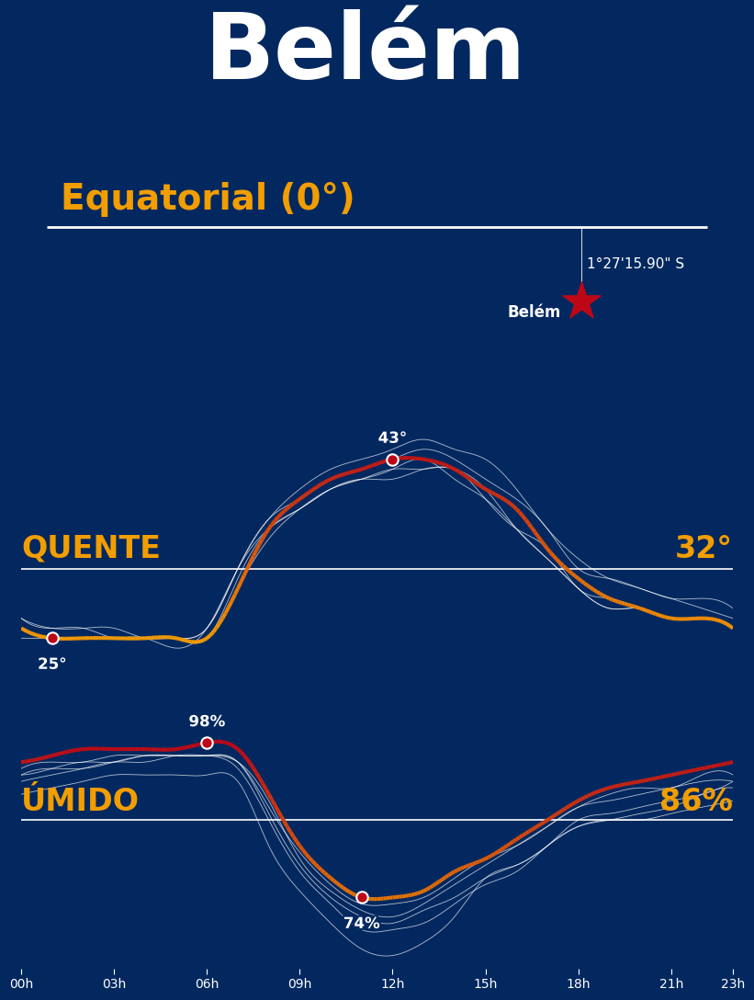

In [0]:
# === COMBO 3 EM 1 (uma coluna) + título gigante "Belém" ===
# Requisitos extras: geobr, shapely, geopandas, seaborn, scipy

# ----------------- imports -----------------
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import LinearSegmentedColormap, Normalize
import matplotlib.patheffects as pe
from scipy.interpolate import make_interp_spline

import geopandas as gpd
from shapely.geometry import LineString, Point
import geobr

# ----------------- estilo/cores globais -----------------
FACE_BG = "#03285F"
COLOR_LOW  = "#F29D00"   # gradiente: valores baixos
COLOR_HIGH = "#BD0717"   # gradiente: valores altos
cmap_hot   = LinearSegmentedColormap.from_list("hot_grad", [COLOR_LOW, COLOR_HIGH])

# ----------------- dados esperados -----------------
# pandas_df deve existir no ambiente com: 
# ano, hora_medicao_prev_hora, hora, anomes, sensacao_termica_max_c, umidade_rel_max_prev_hora_pct
df_base = pandas_df.copy()

# ----------------- helpers -----------------
def smooth_xy(x, y, step=0.1):
    """Spline cúbica para densificar amostras."""
    x = np.asarray(x, dtype=float)
    y = np.asarray(y, dtype=float)
    uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
    xu = uniq["x"].values
    yu = uniq["y"].values
    if len(xu) < 2:
        return xu, yu
    xs = np.arange(xu.min(), xu.max() + 1e-9, step)
    ys = make_interp_spline(xu, yu, k=3)(xs)
    return xs, ys

def linecollection_gradient(ax, xs, ys, cmap, norm, lw=3, z=3):
    """Desenha uma linha com gradiente por Y usando LineCollection."""
    pts = np.array([xs, ys]).T.reshape(-1, 1, 2)
    seg = np.concatenate([pts[:-1], pts[1:]], axis=1)
    ys_mid = (ys[:-1] + ys[1:]) / 2.0
    lc = LineCollection(seg, cmap=cmap, norm=norm, linewidth=lw, zorder=z)
    lc.set_array(ys_mid)
    ax.add_collection(lc)

def dec_to_dms_lat(dec_lat: float) -> str:
    s = "S" if dec_lat < 0 else "N"
    v = abs(dec_lat)
    deg = int(v)
    minutes_full = (v - deg) * 60
    minutes = int(minutes_full)
    seconds = (minutes_full - minutes) * 60
    return f"{deg}°{minutes:02d}'{seconds:05.2f}\" {s}"

# ----------------- prepara dados para gráficos 2 e 3 -----------------
df = df_base.copy()
df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")

# TEMP: sensação térmica
df_temp = df.dropna(subset=["hora", "sensacao_termica_max_c", "ano"]).copy()
df_temp = (
    df_temp.groupby(["ano", "hora"], as_index=False)["sensacao_termica_max_c"]
           .mean().sort_values(["ano", "hora"])
)

# HUMID: umidade
METRIC = "umidade_rel_max_prev_hora_pct"
REF_Y  = 86
REF_LABEL_LEFT, REF_LABEL_RIGHT = "ÚMIDO", "86%"
df_hum = df.dropna(subset=["hora", METRIC, "ano"]).copy()
df_hum = (
    df_hum.groupby(["ano", "hora"], as_index=False)[METRIC]
          .mean().sort_values(["ano", "hora"])
)

# normalizações p/ gradientes
norm_temp = Normalize(vmin=float(df_temp["sensacao_termica_max_c"].min()),
                      vmax=float(df_temp["sensacao_termica_max_c"].max()))
norm_hum  = Normalize(vmin=float(df_hum[METRIC].min()),
                      vmax=float(df_hum[METRIC].max()))

# ----------------- figura & eixos -----------------
plt.rcParams.update({"figure.facecolor": FACE_BG, "axes.facecolor": FACE_BG})
fig = plt.figure(figsize=(10, 12))
gs = fig.add_gridspec(nrows=3, ncols=1, height_ratios=[1, 1, 1], hspace=0.28)

ax1 = fig.add_subplot(gs[0, 0])  # Equador + estrela
ax2 = fig.add_subplot(gs[1, 0])  # Temperatura
ax3 = fig.add_subplot(gs[2, 0])  # Umidade

# ----------------- wordmark gigante "Belém" -----------------
fig.text(0.5, 0.98, "Belém", ha="center", va="top",
         fontsize=72, color="white", fontweight="bold")

# ============================================================
# GRÁFICO 1 — Equador + estrela Belém + perpendicular
# ============================================================
YEAR = 2020
MARCOZERO_LAT = -1.454417
MARCOZERO_LON = -48.505285

gdf_pa = geobr.read_state(code_state="PA", year=YEAR, simplified=True).to_crs(4326)
minx, _, maxx, _ = gdf_pa.total_bounds

equator_line = LineString([(minx, 0.0), (maxx, 0.0)])
marcozero_pt = Point(MARCOZERO_LON, MARCOZERO_LAT)

# Linha do Equador (branca)
gpd.GeoSeries([equator_line], crs=4326).plot(ax=ax1, color="white", linewidth=2, zorder=3)

# Rótulo "Equatorial (0°)" à esquerda (ajuste fino aqui se quiser)
span_x = maxx - minx
EQ_LABEL_X_OFFSET_FRAC = 0.02
EQ_LABEL_Y_OFFSET = 0.20
ax1.text(minx + span_x*EQ_LABEL_X_OFFSET_FRAC, 0.0 + EQ_LABEL_Y_OFFSET,
         "Equatorial (0°)", color="#F29D00", ha="left", va="bottom",
         fontsize=28, fontweight="bold", zorder=4)

# Estrela (Belém)
gpd.GeoSeries([marcozero_pt], crs=4326).plot(
    ax=ax1, color=COLOR_HIGH, markersize=960, marker="*", zorder=5
)

# Perpendicular até a linha do Equador
ax1.plot([MARCOZERO_LON, MARCOZERO_LON], [0.0, MARCOZERO_LAT],
         color="white", linewidth=0.8, alpha=0.8, zorder=4)
ax1.text(MARCOZERO_LON + 0.10, (MARCOZERO_LAT + 0.0)/2,
         dec_to_dms_lat(MARCOZERO_LAT),
         color="white", ha="left", va="center", fontsize=11, zorder=6)

# Rótulo “Belém” à esquerda da estrela
ax1.text(MARCOZERO_LON - 0.40, MARCOZERO_LAT - 0.05,
         "Belém", color="white", ha="right", va="top",
         fontsize=12, fontweight="bold", zorder=6)

# Enquadramento e limpeza
PAD_UP, PAD_DOWN = 1.5, 0.5
ymin = min(MARCOZERO_LAT, 0.0) - PAD_DOWN
ymax = max(MARCOZERO_LAT, 0.0) + PAD_UP
ax1.set_ylim(ymin, ymax)
ax1.set_xlim(minx - 0.5, maxx + 0.5)
ax1.set_xlabel(""); ax1.set_ylabel("")
ax1.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for s in ax1.spines.values(): s.set_visible(False)

# ============================================================
# GRÁFICO 2 — Temperatura (sensação térmica) com gradiente (2025)
# ============================================================
# anos exceto 2025
for a in sorted(df_temp["ano"].unique()):
    if a == 2025:
        continue
    sub = df_temp[df_temp["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub["sensacao_termica_max_c"].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax2, color="white", linewidth=0.6, alpha=0.7, legend=False)

# 2025 com gradiente
if (df_temp["ano"] == 2025).any():
    sub25 = df_temp[df_temp["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25["sensacao_termica_max_c"].values, step=0.1)
    linecollection_gradient(ax2, xs25, ys25, cmap_hot, norm_temp, lw=3, z=3)

    # pontos reais para rótulos (máx/mín)
    idx_max = sub25["sensacao_termica_max_c"].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25["sensacao_termica_max_c"].idxmin(); row_min = sub25.loc[idx_min]

    ax2.scatter(row_max["hora"], row_max["sensacao_termica_max_c"],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax2.annotate(f'{int(round(row_max["sensacao_termica_max_c"]))}°',
                 xy=(row_max["hora"], row_max["sensacao_termica_max_c"]),
                 xytext=(0, 10), textcoords="offset points",
                 ha="center", va="bottom", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

    ax2.scatter(row_min["hora"], row_min["sensacao_termica_max_c"],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax2.annotate(f'{int(round(row_min["sensacao_termica_max_c"]))}°',
                 xy=(row_min["hora"], row_min["sensacao_termica_max_c"]),
                 xytext=(0, -14), textcoords="offset points",
                 ha="center", va="top", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

# limites e limpeza
ax2.set_xlim(0, 23)
ax2.set_ylim(float(df_temp["sensacao_termica_max_c"].min()) - 1.5,
             float(df_temp["sensacao_termica_max_c"].max()) + 1.5)
ax2.set_xlabel(""); ax2.set_ylabel("")
ax2.grid(False)
sns.despine(ax=ax2, left=True, bottom=True)
ax2.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for s in ax2.spines.values(): s.set_visible(False)

# Linha e rótulos de referência para temperatura (opcional)
ax2.axhline(y=32, color="white", linewidth=1.2, zorder=0)
ax2.text(0, 32.5, "QUENTE", va="bottom", ha="left", fontsize=24,
         color=COLOR_LOW, fontweight="bold")
ax2.text(23, 32.5, "32°", va="bottom", ha="right", fontsize=24,
         color=COLOR_LOW, fontweight="bold")

# ============================================================
# GRÁFICO 3 — Umidade com gradiente (2025) + linha 86%
# ============================================================
# anos exceto 2025
for a in sorted(df_hum["ano"].unique()):
    if a == 2025:
        continue
    sub = df_hum[df_hum["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub[METRIC].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax3, color="white", linewidth=0.6, alpha=0.7, legend=False)

# 2025 com gradiente
if (df_hum["ano"] == 2025).any():
    sub25 = df_hum[df_hum["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25[METRIC].values, step=0.1)
    linecollection_gradient(ax3, xs25, ys25, cmap_hot, norm_hum, lw=3, z=3)

    # pontos reais para rótulos (máx/mín)
    idx_max = sub25[METRIC].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25[METRIC].idxmin(); row_min = sub25.loc[idx_min]

    ax3.scatter(row_max["hora"], row_max[METRIC],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax3.annotate(f'{int(round(row_max[METRIC]))}%',
                 xy=(row_max["hora"], row_max[METRIC]),
                 xytext=(0, 10), textcoords="offset points",
                 ha="center", va="bottom", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

    ax3.scatter(row_min["hora"], row_min[METRIC],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax3.annotate(f'{int(round(row_min[METRIC]))}%',
                 xy=(row_min["hora"], row_min[METRIC]),
                 xytext=(0, -14), textcoords="offset points",
                 ha="center", va="top", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

# linha de referência da umidade
y_vals_all = df_hum[METRIC].values
pad = max(2, 0.05 * (y_vals_all.max() - y_vals_all.min() if len(y_vals_all) else 10))
ax3.set_xlim(0, 23)
ax3.set_ylim(min(y_vals_all.min() - pad, REF_Y - 2), max(y_vals_all.max() + pad, REF_Y + 2))
ax3.axhline(y=REF_Y, color="white", linewidth=1.2, zorder=0)
ax3.text(0, REF_Y + 0.5, REF_LABEL_LEFT,  va="bottom", ha="left",  fontsize=24,
         color=COLOR_LOW, fontweight="bold")
ax3.text(23, REF_Y + 0.5, REF_LABEL_RIGHT, va="bottom", ha="right", fontsize=24,
         color=COLOR_LOW, fontweight="bold")

# limpeza + Ticks no X (somente no último gráfico)
ax3.set_xlabel(""); ax3.set_ylabel("")
ax3.grid(False)
sns.despine(ax=ax3, left=True, bottom=True)

# --- Ticks de 3 em 3 horas + 23h no último gráfico ---
ticks_3h = list(range(0, 24, 3))
if 23 not in ticks_3h:
    ticks_3h.append(23)
labels_3h = [f"{h:02d}h" for h in ticks_3h]

ax3.set_xticks(ticks_3h)
ax3.set_xticklabels(labels_3h, rotation=0, color="white")
ax3.tick_params(
    axis="x",
    bottom=True,           # exibe os ticks do eixo X
    labelbottom=True,      # exibe os rótulos do eixo X
    length=4,              # tamanho dos “risquinhos” (opcional)
    colors="white"         # cor dos ticks (opcional)
)
# mantém o eixo Y limpo
ax3.tick_params(axis="y", left=False, labelleft=False)

# pode manter as bordas ocultas para look “clean”
for s in ax3.spines.values():
    s.set_visible(False)


# ----------------- render -----------------
plt.tight_layout(rect=[0.03, 0.02, 0.97, 0.95])  # deixa espaço superior para o "Belém"
plt.show()


/home/spark-0ea60372-bbd4-4992-ba8e-f6/.ipykernel/3996/command-8154717432975993-1658121500:289: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(h_pad=0.10, rect=[0.03, 0.02, 0.97, 0.95])  # deixa espaço superior para o "Belém"


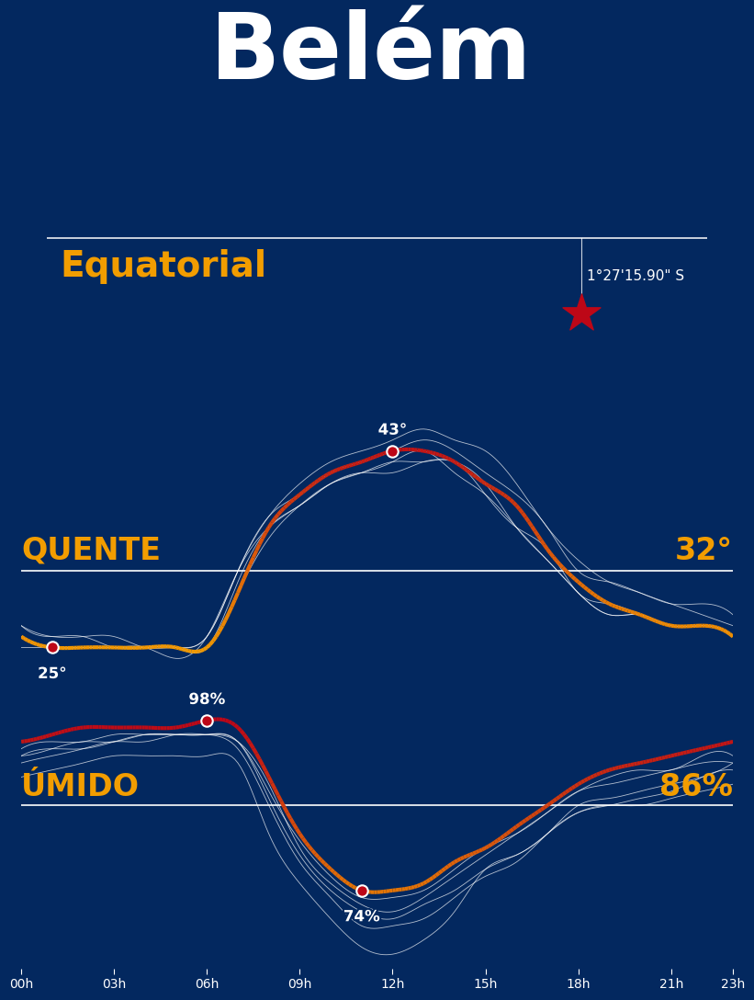

In [0]:
# === COMBO 3 EM 1 (uma coluna) + título gigante "Belém" ===
# Requisitos extras: geobr, shapely, geopandas, seaborn, scipy

# ----------------- imports -----------------
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import LinearSegmentedColormap, Normalize
import matplotlib.patheffects as pe
from scipy.interpolate import make_interp_spline

import geopandas as gpd
from shapely.geometry import LineString, Point
import geobr

# ----------------- estilo/cores globais -----------------
FACE_BG = "#03285F"
COLOR_LOW  = "#F29D00"   # gradiente: valores baixos
COLOR_HIGH = "#BD0717"   # gradiente: valores altos
cmap_hot   = LinearSegmentedColormap.from_list("hot_grad", [COLOR_LOW, COLOR_HIGH])

# ----------------- dados esperados -----------------
# pandas_df deve existir no ambiente com: 
# ano, hora_medicao_prev_hora, hora, anomes, sensacao_termica_max_c, umidade_rel_max_prev_hora_pct
df_base = pandas_df.copy()

# ----------------- helpers -----------------
def smooth_xy(x, y, step=0.1):
    """Spline cúbica para densificar amostras."""
    x = np.asarray(x, dtype=float)
    y = np.asarray(y, dtype=float)
    uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
    xu = uniq["x"].values
    yu = uniq["y"].values
    if len(xu) < 2:
        return xu, yu
    xs = np.arange(xu.min(), xu.max() + 1e-9, step)
    ys = make_interp_spline(xu, yu, k=3)(xs)
    return xs, ys

def linecollection_gradient(ax, xs, ys, cmap, norm, lw=3, z=3):
    """Desenha uma linha com gradiente por Y usando LineCollection."""
    pts = np.array([xs, ys]).T.reshape(-1, 1, 2)
    seg = np.concatenate([pts[:-1], pts[1:]], axis=1)
    ys_mid = (ys[:-1] + ys[1:]) / 2.0
    lc = LineCollection(seg, cmap=cmap, norm=norm, linewidth=lw, zorder=z)
    lc.set_array(ys_mid)
    ax.add_collection(lc)

def dec_to_dms_lat(dec_lat: float) -> str:
    s = "S" if dec_lat < 0 else "N"
    v = abs(dec_lat)
    deg = int(v)
    minutes_full = (v - deg) * 60
    minutes = int(minutes_full)
    seconds = (minutes_full - minutes) * 60
    return f"{deg}°{minutes:02d}'{seconds:05.2f}\" {s}"

# ----------------- prepara dados para gráficos 2 e 3 -----------------
df = df_base.copy()
df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")

# TEMP: sensação térmica
df_temp = df.dropna(subset=["hora", "sensacao_termica_max_c", "ano"]).copy()
df_temp = (
    df_temp.groupby(["ano", "hora"], as_index=False)["sensacao_termica_max_c"]
           .mean().sort_values(["ano", "hora"])
)

# HUMID: umidade
METRIC = "umidade_rel_max_prev_hora_pct"
REF_Y  = 86
REF_LABEL_LEFT, REF_LABEL_RIGHT = "ÚMIDO", "86%"
df_hum = df.dropna(subset=["hora", METRIC, "ano"]).copy()
df_hum = (
    df_hum.groupby(["ano", "hora"], as_index=False)[METRIC]
          .mean().sort_values(["ano", "hora"])
)

# normalizações p/ gradientes
norm_temp = Normalize(vmin=float(df_temp["sensacao_termica_max_c"].min()),
                      vmax=float(df_temp["sensacao_termica_max_c"].max()))
norm_hum  = Normalize(vmin=float(df_hum[METRIC].min()),
                      vmax=float(df_hum[METRIC].max()))

# ----------------- figura & eixos -----------------
plt.rcParams.update({"figure.facecolor": FACE_BG, "axes.facecolor": FACE_BG})
fig = plt.figure(figsize=(10, 12))
gs = fig.add_gridspec(nrows=3, ncols=1, height_ratios=[1, 1, 1], hspace=0.12)

ax1 = fig.add_subplot(gs[0, 0])  # Equador + estrela
ax2 = fig.add_subplot(gs[1, 0])  # Temperatura
ax3 = fig.add_subplot(gs[2, 0])  # Umidade

# ----------------- wordmark gigante "Belém" -----------------
TITLE_SHIFT = 0.006  # ajuste fino: 0.003–0.015
fig.text(0.5 + TITLE_SHIFT, 0.98, "Belém",
         ha="center", va="top",
         fontsize=72, color="white", fontweight="bold")

# ============================================================
# GRÁFICO 1 — Equador + estrela Belém + perpendicular
# ============================================================
YEAR = 2020
MARCOZERO_LAT = -1.454417
MARCOZERO_LON = -48.505285

gdf_pa = geobr.read_state(code_state="PA", year=YEAR, simplified=True).to_crs(4326)
minx, _, maxx, _ = gdf_pa.total_bounds

equator_line = LineString([(minx, 0.0), (maxx, 0.0)])
marcozero_pt = Point(MARCOZERO_LON, MARCOZERO_LAT)

# Linha do Equador (branca)
gpd.GeoSeries([equator_line], crs=4326).plot(ax=ax1, color="white", linewidth=1.1, zorder=3)

# Rótulo "Equatorial (0°)" à esquerda (ajuste fino aqui se quiser)
span_x = maxx - minx
EQ_LABEL_X_OFFSET_FRAC = 0.02
EQ_LABEL_Y_OFFSET = 0.20
ax1.text(
    minx + span_x*EQ_LABEL_X_OFFSET_FRAC, 
    0.0 - EQ_LABEL_Y_OFFSET,
    "Equatorial", 
    color="#F29D00", 
    ha="left", 
    va="top",
    fontsize=28, 
    fontweight="bold", 
    zorder=4
)

# Estrela (Belém)
gpd.GeoSeries([marcozero_pt], crs=4326).plot(
    ax=ax1, color=COLOR_HIGH, markersize=960, marker="*", zorder=5
)

# Perpendicular até a linha do Equador
ax1.plot([MARCOZERO_LON, MARCOZERO_LON], [0.0, MARCOZERO_LAT],
         color="white", linewidth=0.8, alpha=0.8, zorder=4)
ax1.text(MARCOZERO_LON + 0.10, (MARCOZERO_LAT + 0.0)/2,
         dec_to_dms_lat(MARCOZERO_LAT),
         color="white", ha="left", va="center", fontsize=11, zorder=6)

# Enquadramento e limpeza
PAD_UP, PAD_DOWN = 1.5, 0.5
ymin = min(MARCOZERO_LAT, 0.0) - PAD_DOWN
ymax = max(MARCOZERO_LAT, 0.0) + PAD_UP
ax1.set_ylim(ymin, ymax)
ax1.set_xlim(minx - 0.5, maxx + 0.5)
ax1.set_xlabel(""); ax1.set_ylabel("")
ax1.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for s in ax1.spines.values(): s.set_visible(False)

# ============================================================
# GRÁFICO 2 — Temperatura (sensação térmica) com gradiente (2025)
# ============================================================
# anos exceto 2025
for a in sorted(df_temp["ano"].unique()):
    if a == 2025:
        continue
    sub = df_temp[df_temp["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub["sensacao_termica_max_c"].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax2, color="white", linewidth=0.6, alpha=0.7, legend=False)

# 2025 com gradiente
if (df_temp["ano"] == 2025).any():
    sub25 = df_temp[df_temp["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25["sensacao_termica_max_c"].values, step=0.1)
    linecollection_gradient(ax2, xs25, ys25, cmap_hot, norm_temp, lw=3, z=3)

    # pontos reais para rótulos (máx/mín)
    idx_max = sub25["sensacao_termica_max_c"].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25["sensacao_termica_max_c"].idxmin(); row_min = sub25.loc[idx_min]

    ax2.scatter(row_max["hora"], row_max["sensacao_termica_max_c"],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax2.annotate(f'{int(round(row_max["sensacao_termica_max_c"]))}°',
                 xy=(row_max["hora"], row_max["sensacao_termica_max_c"]),
                 xytext=(0, 10), textcoords="offset points",
                 ha="center", va="bottom", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

    ax2.scatter(row_min["hora"], row_min["sensacao_termica_max_c"],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax2.annotate(f'{int(round(row_min["sensacao_termica_max_c"]))}°',
                 xy=(row_min["hora"], row_min["sensacao_termica_max_c"]),
                 xytext=(0, -14), textcoords="offset points",
                 ha="center", va="top", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

# limites e limpeza
ax2.set_xlim(0, 23)
ax2.set_ylim(float(df_temp["sensacao_termica_max_c"].min()) - 1.5,
             float(df_temp["sensacao_termica_max_c"].max()) + 1.5)
ax2.set_xlabel(""); ax2.set_ylabel("")
ax2.grid(False)
sns.despine(ax=ax2, left=True, bottom=True)
ax2.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for s in ax2.spines.values(): s.set_visible(False)

# Linha e rótulos de referência para temperatura (opcional)
ax2.axhline(y=32, color="white", linewidth=1.2, zorder=0)
ax2.text(0, 32.5, "QUENTE", va="bottom", ha="left", fontsize=24,
         color=COLOR_LOW, fontweight="bold")
ax2.text(23, 32.5, "32°", va="bottom", ha="right", fontsize=24,
         color=COLOR_LOW, fontweight="bold")

# ============================================================
# GRÁFICO 3 — Umidade com gradiente (2025) + linha 86%
# ============================================================
# anos exceto 2025
for a in sorted(df_hum["ano"].unique()):
    if a == 2025:
        continue
    sub = df_hum[df_hum["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub[METRIC].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax3, color="white", linewidth=0.6, alpha=0.7, legend=False)

# 2025 com gradiente
if (df_hum["ano"] == 2025).any():
    sub25 = df_hum[df_hum["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25[METRIC].values, step=0.1)
    linecollection_gradient(ax3, xs25, ys25, cmap_hot, norm_hum, lw=3, z=3)

    # pontos reais para rótulos (máx/mín)
    idx_max = sub25[METRIC].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25[METRIC].idxmin(); row_min = sub25.loc[idx_min]

    ax3.scatter(row_max["hora"], row_max[METRIC],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax3.annotate(f'{int(round(row_max[METRIC]))}%',
                 xy=(row_max["hora"], row_max[METRIC]),
                 xytext=(0, 10), textcoords="offset points",
                 ha="center", va="bottom", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

    ax3.scatter(row_min["hora"], row_min[METRIC],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax3.annotate(f'{int(round(row_min[METRIC]))}%',
                 xy=(row_min["hora"], row_min[METRIC]),
                 xytext=(0, -14), textcoords="offset points",
                 ha="center", va="top", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

# linha de referência da umidade
y_vals_all = df_hum[METRIC].values
pad = max(2, 0.05 * (y_vals_all.max() - y_vals_all.min() if len(y_vals_all) else 10))
ax3.set_xlim(0, 23)
ax3.set_ylim(min(y_vals_all.min() - pad, REF_Y - 2), max(y_vals_all.max() + pad, REF_Y + 2))
ax3.axhline(y=REF_Y, color="white", linewidth=1.2, zorder=0)
ax3.text(0, REF_Y + 0.5, REF_LABEL_LEFT,  va="bottom", ha="left",  fontsize=24,
         color=COLOR_LOW, fontweight="bold")
ax3.text(23, REF_Y + 0.5, REF_LABEL_RIGHT, va="bottom", ha="right", fontsize=24,
         color=COLOR_LOW, fontweight="bold")

# limpeza + Ticks no X (somente no último gráfico)
ax3.set_xlabel(""); ax3.set_ylabel("")
ax3.grid(False)
sns.despine(ax=ax3, left=True, bottom=True)

# --- Ticks de 3 em 3 horas + 23h no último gráfico ---
ticks_3h = list(range(0, 24, 3))
if 23 not in ticks_3h:
    ticks_3h.append(23)
labels_3h = [f"{h:02d}h" for h in ticks_3h]

ax3.set_xticks(ticks_3h)
ax3.set_xticklabels(labels_3h, rotation=0, color="white")
ax3.tick_params(
    axis="x",
    bottom=True,           # exibe os ticks do eixo X
    labelbottom=True,      # exibe os rótulos do eixo X
    length=4,              # tamanho dos “risquinhos” (opcional)
    colors="white"         # cor dos ticks (opcional)
)
# mantém o eixo Y limpo
ax3.tick_params(axis="y", left=False, labelleft=False)

# pode manter as bordas ocultas para look “clean”
for s in ax3.spines.values():
    s.set_visible(False)


# ----------------- render -----------------
plt.tight_layout(h_pad=0.10, rect=[0.03, 0.02, 0.97, 0.95])  # deixa espaço superior para o "Belém"
plt.show()


/home/spark-0ea60372-bbd4-4992-ba8e-f6/.ipykernel/3996/command-5695512252459710-1082396347:287: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(h_pad=0.10, rect=[0.03, 0.02, 0.97, 0.95])


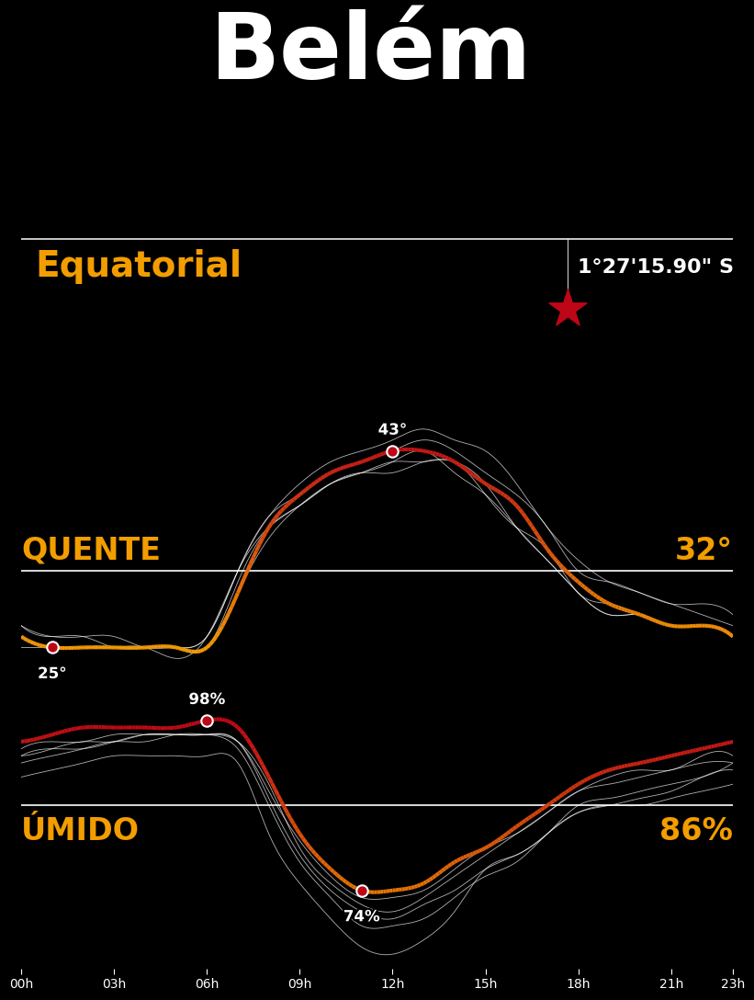

Imagem salva em alta resolução: /Volumes/projetos/belem/raw/belem_combo.png


In [0]:
# === COMBO 3 EM 1 (uma coluna) + título gigante "Belém" ===
# Requisitos extras: geobr, shapely, geopandas, seaborn, scipy

# ----------------- imports -----------------
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import LinearSegmentedColormap, Normalize
import matplotlib.patheffects as pe
from scipy.interpolate import make_interp_spline

import geopandas as gpd
from shapely.geometry import LineString, Point
import geobr

# ----------------- estilo/cores globais -----------------
FACE_BG = "#000000"
# FACE_BG = "#03285F"
COLOR_LOW  = "#F29D00"   # gradiente: valores baixos
COLOR_HIGH = "#BD0717"   # gradiente: valores altos
cmap_hot   = LinearSegmentedColormap.from_list("hot_grad", [COLOR_LOW, COLOR_HIGH])

# ----------------- dados esperados -----------------
# pandas_df deve existir no ambiente com:
# ano, hora_medicao_prev_hora, hora, anomes, sensacao_termica_max_c, umidade_rel_max_prev_hora_pct
df_base = pandas_df.copy()

# ----------------- helpers -----------------
def smooth_xy(x, y, step=0.1):
    """Spline cúbica para densificar amostras."""
    x = np.asarray(x, dtype=float)
    y = np.asarray(y, dtype=float)
    uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
    xu = uniq["x"].values
    yu = uniq["y"].values
    if len(xu) < 2:
        return xu, yu
    xs = np.arange(xu.min(), xu.max() + 1e-9, step)
    ys = make_interp_spline(xu, yu, k=3)(xs)
    return xs, ys

def linecollection_gradient(ax, xs, ys, cmap, norm, lw=3, z=3):
    """Desenha uma linha com gradiente por Y usando LineCollection."""
    pts = np.array([xs, ys]).T.reshape(-1, 1, 2)
    seg = np.concatenate([pts[:-1], pts[1:]], axis=1)
    ys_mid = (ys[:-1] + ys[1:]) / 2.0
    lc = LineCollection(seg, cmap=cmap, norm=norm, linewidth=lw, zorder=z)
    lc.set_array(ys_mid)
    ax.add_collection(lc)

def dec_to_dms_lat(dec_lat: float) -> str:
    s = "S" if dec_lat < 0 else "N"
    v = abs(dec_lat)
    deg = int(v)
    minutes_full = (v - deg) * 60
    minutes = int(minutes_full)
    seconds = (minutes_full - minutes) * 60
    return f"{deg}°{minutes:02d}'{seconds:05.2f}\" {s}"

# ----------------- prepara dados para gráficos 2 e 3 -----------------
df = df_base.copy()
df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")

# TEMP: sensação térmica
df_temp = df.dropna(subset=["hora", "sensacao_termica_max_c", "ano"]).copy()
df_temp = (
    df_temp.groupby(["ano", "hora"], as_index=False)["sensacao_termica_max_c"]
           .mean().sort_values(["ano", "hora"])
)

# HUMID: umidade
METRIC = "umidade_rel_max_prev_hora_pct"
REF_Y  = 86
REF_LABEL_LEFT, REF_LABEL_RIGHT = "ÚMIDO", "86%"
df_hum = df.dropna(subset=["hora", METRIC, "ano"]).copy()
df_hum = (
    df_hum.groupby(["ano", "hora"], as_index=False)[METRIC]
          .mean().sort_values(["ano", "hora"])
)

# normalizações p/ gradientes
norm_temp = Normalize(vmin=float(df_temp["sensacao_termica_max_c"].min()),
                      vmax=float(df_temp["sensacao_termica_max_c"].max()))
norm_hum  = Normalize(vmin=float(df_hum[METRIC].min()),
                      vmax=float(df_hum[METRIC].max()))

# ----------------- figura & eixos -----------------
plt.rcParams.update({"figure.facecolor": FACE_BG, "axes.facecolor": FACE_BG})
fig = plt.figure(figsize=(10, 12))
gs = fig.add_gridspec(nrows=3, ncols=1, height_ratios=[1, 1, 1], hspace=0.12)

ax1 = fig.add_subplot(gs[0, 0])  # Equador + estrela
ax2 = fig.add_subplot(gs[1, 0])  # Temperatura
ax3 = fig.add_subplot(gs[2, 0])  # Umidade

# ----------------- wordmark gigante "Belém" -----------------
TITLE_SHIFT = 0.006  # "espaço" visual à esquerda do título (ajuste fino: 0.003–0.015)
fig.text(0.5 + TITLE_SHIFT, 0.98, "Belém",
         ha="center", va="top",
         fontsize=72, color="white", fontweight="bold")

# ============================================================
# GRÁFICO 1 — Equador + estrela Belém + perpendicular
# ============================================================
YEAR = 2020
MARCOZERO_LAT = -1.454417
MARCOZERO_LON = -48.505285

gdf_pa = geobr.read_state(code_state="PA", year=YEAR, simplified=True).to_crs(4326)
minx, _, maxx, _ = gdf_pa.total_bounds

# (mantemos a geometria para referência, mas vamos desenhar a linha manualmente)
equator_line = LineString([(minx, 0.0), (maxx, 0.0)])
marcozero_pt = Point(MARCOZERO_LON, MARCOZERO_LAT)

# ----- Enquadramento e limpeza + extensão do eixo do 1º gráfico -----
X_PAD = 1.0  # quanto estender à esquerda/direita (em graus)
PAD_UP, PAD_DOWN = 1.5, 0.5
ymin = min(MARCOZERO_LAT, 0.0) - PAD_DOWN
ymax = max(MARCOZERO_LAT, 0.0) + PAD_UP
ax1.set_ylim(ymin, ymax)
ax1.set_xlim(minx - X_PAD, maxx + X_PAD)

# >>> Linha do Equador ocupando toda a largura do eixo
xmin, xmax = ax1.get_xlim()
ax1.hlines(0.0, xmin, xmax, color="white", linewidth=1.1, zorder=3)

# >>> Rótulo "Equatorial" (abaixo da linha, ancorado em fração da largura)
EQ_LABEL_X_OFFSET_FRAC = 0.02
EQ_LABEL_Y_OFFSET = 0.20
span_x = xmax - xmin
ax1.text(
    xmin + span_x * EQ_LABEL_X_OFFSET_FRAC,
    0.0 - EQ_LABEL_Y_OFFSET,
    "Equatorial",
    color="#F29D00",
    ha="left", va="top",
    fontsize=28, fontweight="bold",
    zorder=4
)

# Estrela (Belém)
gpd.GeoSeries([marcozero_pt], crs=4326).plot(
    ax=ax1, color=COLOR_HIGH, markersize=960, marker="*", zorder=5
)

# Perpendicular até a linha do Equador
ax1.plot([MARCOZERO_LON, MARCOZERO_LON], [0.0, MARCOZERO_LAT],
         color="white", linewidth=0.8, alpha=0.8, zorder=4)
ax1.text(MARCOZERO_LON + 0.2, (MARCOZERO_LAT + 0.3)/2,
         dec_to_dms_lat(MARCOZERO_LAT),
         color="white", ha="left", va="center", fontsize=16, fontweight="bold", zorder=6)

ax1.set_xlabel(""); ax1.set_ylabel("")
ax1.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for s in ax1.spines.values(): s.set_visible(False)

# ============================================================
# GRÁFICO 2 — Temperatura (sensação térmica) com gradiente (2025)
# ============================================================
# anos exceto 2025
for a in sorted(df_temp["ano"].unique()):
    if a == 2025:
        continue
    sub = df_temp[df_temp["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub["sensacao_termica_max_c"].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax2, color="white", linewidth=0.6, alpha=0.7, legend=False)

# 2025 com gradiente
if (df_temp["ano"] == 2025).any():
    sub25 = df_temp[df_temp["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25["sensacao_termica_max_c"].values, step=0.1)
    linecollection_gradient(ax2, xs25, ys25, cmap_hot, norm_temp, lw=3, z=3)

    # pontos reais para rótulos (máx/mín)
    idx_max = sub25["sensacao_termica_max_c"].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25["sensacao_termica_max_c"].idxmin(); row_min = sub25.loc[idx_min]

    ax2.scatter(row_max["hora"], row_max["sensacao_termica_max_c"],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax2.annotate(f'{int(round(row_max["sensacao_termica_max_c"]))}°',
                 xy=(row_max["hora"], row_max["sensacao_termica_max_c"]),
                 xytext=(0, 10), textcoords="offset points",
                 ha="center", va="bottom", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

    ax2.scatter(row_min["hora"], row_min["sensacao_termica_max_c"],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax2.annotate(f'{int(round(row_min["sensacao_termica_max_c"]))}°',
                 xy=(row_min["hora"], row_min["sensacao_termica_max_c"]),
                 xytext=(0, -14), textcoords="offset points",
                 ha="center", va="top", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

# limites e limpeza
ax2.set_xlim(0, 23)
ax2.set_ylim(float(df_temp["sensacao_termica_max_c"].min()) - 1.5,
             float(df_temp["sensacao_termica_max_c"].max()) + 1.5)
ax2.set_xlabel(""); ax2.set_ylabel("")
ax2.grid(False)
sns.despine(ax=ax2, left=True, bottom=True)
ax2.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for s in ax2.spines.values(): s.set_visible(False)

# Linha e rótulos de referência para temperatura (opcional)
ax2.axhline(y=32, color="white", linewidth=1.2, zorder=0)
ax2.text(0, 32.5, "QUENTE", va="bottom", ha="left", fontsize=24,
         color=COLOR_LOW, fontweight="bold")
ax2.text(23, 32.5, "32°", va="bottom", ha="right", fontsize=24,
         color=COLOR_LOW, fontweight="bold")

# ============================================================
# GRÁFICO 3 — Umidade com gradiente (2025) + linha 86%
# ============================================================
# anos exceto 2025
for a in sorted(df_hum["ano"].unique()):
    if a == 2025:
        continue
    sub = df_hum[df_hum["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub[METRIC].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax3, color="white", linewidth=0.6, alpha=0.7, legend=False)

# 2025 com gradiente
if (df_hum["ano"] == 2025).any():
    sub25 = df_hum[df_hum["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25[METRIC].values, step=0.1)
    linecollection_gradient(ax3, xs25, ys25, cmap_hot, norm_hum, lw=3, z=3)

    # pontos reais para rótulos (máx/mín)
    idx_max = sub25[METRIC].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25[METRIC].idxmin(); row_min = sub25.loc[idx_min]

    ax3.scatter(row_max["hora"], row_max[METRIC],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax3.annotate(f'{int(round(row_max[METRIC]))}%',
                 xy=(row_max["hora"], row_max[METRIC]),
                 xytext=(0, 10), textcoords="offset points",
                 ha="center", va="bottom", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

    ax3.scatter(row_min["hora"], row_min[METRIC],
                s=80, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax3.annotate(f'{int(round(row_min[METRIC]))}%',
                 xy=(row_min["hora"], row_min[METRIC]),
                 xytext=(0, -14), textcoords="offset points",
                 ha="center", va="top", color="white", fontsize=12, fontweight="bold",
                 path_effects=[pe.withStroke(linewidth=3, foreground=FACE_BG)])

# --- Linha de referência da umidade (rótulos abaixo da linha) ---
y_vals_all = df_hum[METRIC].values
pad = max(2, 0.05 * (y_vals_all.max() - y_vals_all.min() if len(y_vals_all) else 10))
ax3.set_xlim(0, 23)
ax3.set_ylim(min(y_vals_all.min() - pad, REF_Y - 2), max(y_vals_all.max() + pad, REF_Y + 2))

ax3.axhline(y=REF_Y, color="white", linewidth=1.2, zorder=0)

LINE_LABEL_OFFSET = 1.5  # ajuste fino da distância para baixo
ax3.text(0,  REF_Y - LINE_LABEL_OFFSET, REF_LABEL_LEFT,
         va="top", ha="left", fontsize=24, color=COLOR_LOW, fontweight="bold")
ax3.text(23, REF_Y - LINE_LABEL_OFFSET, REF_LABEL_RIGHT,
         va="top", ha="right", fontsize=24, color=COLOR_LOW, fontweight="bold")


# limpeza + Ticks no X (somente no último gráfico)
ax3.set_xlabel(""); ax3.set_ylabel("")
ax3.grid(False)
sns.despine(ax=ax3, left=True, bottom=True)

# --- Ticks de 3 em 3 horas + 23h no último gráfico ---
ticks_3h = list(range(0, 24, 3))
if 23 not in ticks_3h:
    ticks_3h.append(23)
labels_3h = [f"{h:02d}h" for h in ticks_3h]

ax3.set_xticks(ticks_3h)
ax3.set_xticklabels(labels_3h, rotation=0, color="white")
ax3.tick_params(axis="x", bottom=True, labelbottom=True, length=4, colors="white")
ax3.tick_params(axis="y", left=False, labelleft=False)

for s in ax3.spines.values():
    s.set_visible(False)

# ----------------- render -----------------
plt.tight_layout(h_pad=0.10, rect=[0.03, 0.02, 0.97, 0.95])
SCALE = 3*3  # 3x pixels
out_png = "/Volumes/projetos/belem/raw/belem_combo.png"

# usa o DPI atual da figura e triplica
fig.savefig(
    out_png,
    dpi=fig.dpi * SCALE,
    facecolor=fig.get_facecolor(),  # mantém o fundo correto (preto/azul)
    bbox_inches="tight",
    pad_inches=0.02
)

plt.show()
print(f"Imagem salva em alta resolução: {out_png}")

findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: 

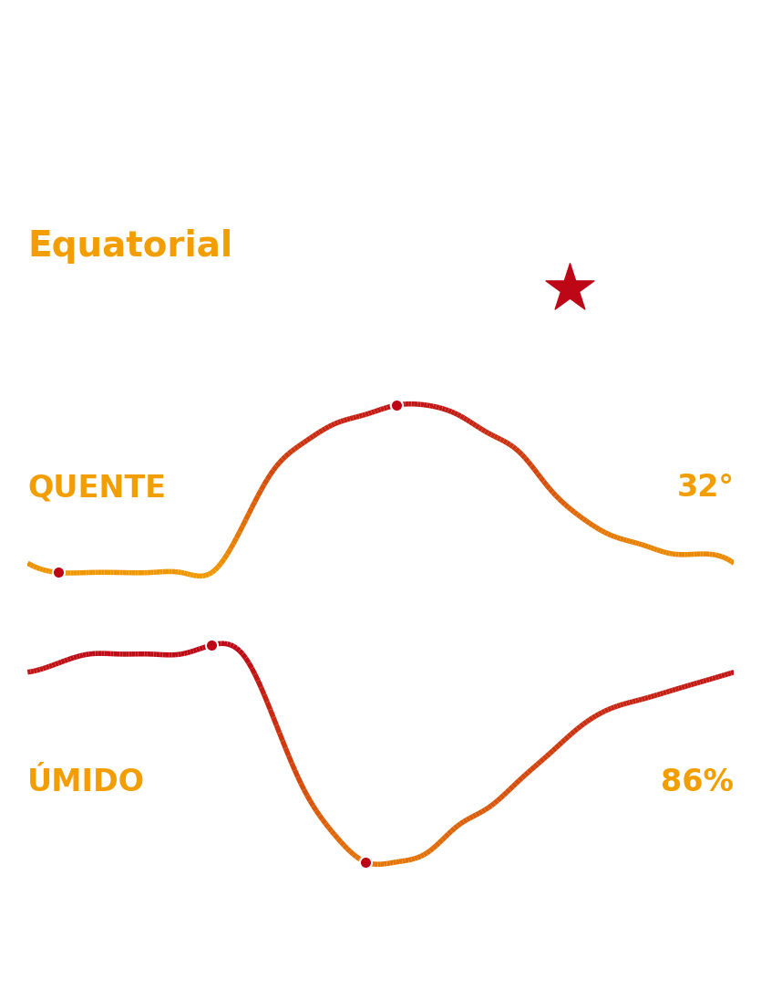

Imagem salva em alta resolução (fundo transparente): /Volumes/projetos/belem/raw/belem_combo.png


In [0]:
# === COMBO 3 EM 1 (uma coluna) + título gigante "Belém" ===
# Requisitos extras: geobr, shapely, geopandas, seaborn, scipy

# ----------------- imports -----------------
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import LinearSegmentedColormap, Normalize
from scipy.interpolate import make_interp_spline

import geopandas as gpd
from shapely.geometry import LineString, Point
import geobr

# ----------------- estilo/cores globais -----------------
# Fundo totalmente transparente
plt.rcParams.update({
    "figure.facecolor": "none",
    "axes.facecolor":   "none",
    "savefig.transparent": True,
    "font.family": "Helvetica",              # força Helvetica
    "font.sans-serif": ["Helvetica", "Arial", "DejaVu Sans", "Liberation Sans"]
})

COLOR_LOW  = "#F29D00"   # gradiente: valores baixos
COLOR_HIGH = "#BD0717"   # gradiente: valores altos
cmap_hot   = LinearSegmentedColormap.from_list("hot_grad", [COLOR_LOW, COLOR_HIGH])

# ----------------- dados esperados -----------------
# pandas_df deve existir no ambiente com:
# ano, hora_medicao_prev_hora, hora, anomes, sensacao_termica_max_c, umidade_rel_max_prev_hora_pct
df_base = pandas_df.copy()

# ----------------- helpers -----------------
def smooth_xy(x, y, step=0.1):
    """Spline cúbica para densificar amostras."""
    x = np.asarray(x, dtype=float)
    y = np.asarray(y, dtype=float)
    uniq = pd.DataFrame({"x": x, "y": y}).groupby("x", as_index=False)["y"].mean()
    xu = uniq["x"].values
    yu = uniq["y"].values
    if len(xu) < 2:
        return xu, yu
    xs = np.arange(xu.min(), xu.max() + 1e-9, step)
    ys = make_interp_spline(xu, yu, k=3)(xs)
    return xs, ys

def linecollection_gradient(ax, xs, ys, cmap, norm, lw=3, z=3):
    """Desenha uma linha com gradiente por Y usando LineCollection."""
    pts = np.array([xs, ys]).T.reshape(-1, 1, 2)
    seg = np.concatenate([pts[:-1], pts[1:]], axis=1)
    ys_mid = (ys[:-1] + ys[1:]) / 2.0
    lc = LineCollection(seg, cmap=cmap, norm=norm, linewidth=lw, zorder=z)
    lc.set_array(ys_mid)
    ax.add_collection(lc)

def dec_to_dms_lat(dec_lat: float) -> str:
    s = "S" if dec_lat < 0 else "N"
    v = abs(dec_lat)
    deg = int(v)
    minutes_full = (v - deg) * 60
    minutes = int(minutes_full)
    seconds = (minutes_full - minutes) * 60
    return f"{deg}°{minutes:02d}'{seconds:05.2f}\" {s}"

# ----------------- prepara dados para gráficos 2 e 3 -----------------
df = df_base.copy()
df["hora"] = pd.to_numeric(df["hora"], errors="coerce")
df["ano"]  = pd.to_numeric(df["ano"], errors="coerce")

# TEMP: sensação térmica
df_temp = df.dropna(subset=["hora", "sensacao_termica_max_c", "ano"]).copy()
df_temp = (
    df_temp.groupby(["ano", "hora"], as_index=False)["sensacao_termica_max_c"]
           .mean().sort_values(["ano", "hora"])
)

# HUMID: umidade
METRIC = "umidade_rel_max_prev_hora_pct"
REF_Y  = 86
REF_LABEL_LEFT, REF_LABEL_RIGHT = "ÚMIDO", "86%"
df_hum = df.dropna(subset=["hora", METRIC, "ano"]).copy()
df_hum = (
    df_hum.groupby(["ano", "hora"], as_index=False)[METRIC]
          .mean().sort_values(["ano", "hora"])
)

# normalizações p/ gradientes
norm_temp = Normalize(vmin=float(df_temp["sensacao_termica_max_c"].min()),
                      vmax=float(df_temp["sensacao_termica_max_c"].max()))
norm_hum  = Normalize(vmin=float(df_hum[METRIC].min()),
                      vmax=float(df_hum[METRIC].max()))

# ----------------- figura & eixos -----------------
fig = plt.figure(figsize=(10, 12))
gs = fig.add_gridspec(nrows=3, ncols=1, height_ratios=[1, 1, 1.5], hspace=0.12)

ax1 = fig.add_subplot(gs[0, 0])  # Equador + estrela
ax2 = fig.add_subplot(gs[1, 0])  # Temperatura
ax3 = fig.add_subplot(gs[2, 0])  # Umidade

# ----------------- wordmark gigante "Belém" -----------------
TITLE_SHIFT = 0.006
fig.text(0.5 + TITLE_SHIFT, 0.98, "Belém",
         ha="center", va="top",
         fontsize=72, color="white", fontweight="bold")

# ============================================================
# GRÁFICO 1 — Equador + estrela Belém + perpendicular
# ============================================================
YEAR = 2020
MARCOZERO_LAT = -1.454417
MARCOZERO_LON = -48.505285

gdf_pa = geobr.read_state(code_state="PA", year=YEAR, simplified=True).to_crs(4326)
minx, _, maxx, _ = gdf_pa.total_bounds

equator_line = LineString([(minx, 0.0), (maxx, 0.0)])
marcozero_pt = Point(MARCOZERO_LON, MARCOZERO_LAT)

# Enquadramento
X_PAD = 1.0
PAD_UP, PAD_DOWN = 1.5, 0.5
ymin = min(MARCOZERO_LAT, 0.0) - PAD_DOWN
ymax = max(MARCOZERO_LAT, 0.0) + PAD_UP
ax1.set_ylim(ymin, ymax)
ax1.set_xlim(minx - X_PAD, maxx + X_PAD)

# Linha do Equador
xmin, xmax = ax1.get_xlim()
ax1.hlines(0.0, xmin, xmax, color="white", linewidth=2, zorder=3)

# Rótulo "Equatorial"
EQ_LABEL_X_OFFSET_FRAC = 0.0
EQ_LABEL_Y_OFFSET = 0.20
span_x = xmax - xmin
ax1.text(
    xmin + span_x * EQ_LABEL_X_OFFSET_FRAC,
    0.0 - EQ_LABEL_Y_OFFSET,
    "Equatorial",
    color="#F29D00",
    ha="left", va="top",
    fontsize=28, fontweight="bold",
    zorder=4
)

# Estrela (Belém)
gpd.GeoSeries([marcozero_pt], crs=4326).plot(
    ax=ax1, color=COLOR_HIGH, markersize=1600, marker="*", zorder=5
)

# Perpendicular até a linha do Equador
ax1.plot([MARCOZERO_LON, MARCOZERO_LON], [0.0, MARCOZERO_LAT],
         color="white", linewidth=2, alpha=0.8, zorder=4)
ax1.text(MARCOZERO_LON + 0.2, (MARCOZERO_LAT + 0.3)/2,
         dec_to_dms_lat(MARCOZERO_LAT),
         color="white", ha="left", va="center", fontsize=16, fontweight="bold", zorder=6)

ax1.set_xlabel(""); ax1.set_ylabel("")
ax1.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for s in ax1.spines.values(): s.set_visible(False)

# ============================================================
# GRÁFICO 2 — Temperatura (sensação térmica) com gradiente (2025)
# ============================================================
# anos exceto 2025
for a in sorted(df_temp["ano"].unique()):
    if a == 2025:
        continue
    sub = df_temp[df_temp["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub["sensacao_termica_max_c"].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax2, color="white", linewidth=2, alpha=0.7, legend=False)

# 2025 com gradiente
if (df_temp["ano"] == 2025).any():
    sub25 = df_temp[df_temp["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25["sensacao_termica_max_c"].values, step=0.1)
    linecollection_gradient(ax2, xs25, ys25, cmap_hot, norm_temp, lw=4, z=3)

    # pontos reais para rótulos (máx/mín) — ANOTAÇÕES MAIORES
    idx_max = sub25["sensacao_termica_max_c"].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25["sensacao_termica_max_c"].idxmin(); row_min = sub25.loc[idx_min]

    ax2.scatter(row_max["hora"], row_max["sensacao_termica_max_c"],
                s=90, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax2.annotate(f'{int(round(row_max["sensacao_termica_max_c"]))}°',
                 xy=(row_max["hora"], row_max["sensacao_termica_max_c"]),
                 xytext=(0, 12), textcoords="offset points",
                 ha="center", va="bottom", color="white", fontsize=22, fontweight="bold")

    ax2.scatter(row_min["hora"], row_min["sensacao_termica_max_c"],
                s=90, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax2.annotate(f'{int(round(row_min["sensacao_termica_max_c"]))}°',
                 xy=(row_min["hora"], row_min["sensacao_termica_max_c"]),
                 xytext=(0, -18), textcoords="offset points",
                 ha="center", va="top", color="white", fontsize=22, fontweight="bold")

# limites e limpeza
ax2.set_xlim(0, 23)
ax2.set_ylim(float(df_temp["sensacao_termica_max_c"].min()) - 1.5,
             float(df_temp["sensacao_termica_max_c"].max()) + 1.5)
ax2.set_xlabel(""); ax2.set_ylabel("")
ax2.grid(False)
sns.despine(ax=ax2, left=True, bottom=True)
ax2.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
for s in ax2.spines.values(): s.set_visible(False)

# Linha e rótulos de referência para temperatura (opcional)
ax2.axhline(y=32, color="white", linewidth=2, zorder=0)
ax2.text(0, 32.5, "QUENTE", va="bottom", ha="left", fontsize=24,
         color=COLOR_LOW, fontweight="bold")
ax2.text(23, 32.5, "32°", va="bottom", ha="right", fontsize=24,
         color=COLOR_LOW, fontweight="bold")

# ============================================================
# GRÁFICO 3 — Umidade com gradiente (2025) + linha 86%
# ============================================================
# anos exceto 2025
for a in sorted(df_hum["ano"].unique()):
    if a == 2025:
        continue
    sub = df_hum[df_hum["ano"] == a]
    xs, ys = smooth_xy(sub["hora"].values, sub[METRIC].values, step=0.1)
    sns.lineplot(x=xs, y=ys, ax=ax3, color="white", linewidth=2, alpha=0.7, legend=False)

# 2025 com gradiente
if (df_hum["ano"] == 2025).any():
    sub25 = df_hum[df_hum["ano"] == 2025].sort_values("hora")
    xs25, ys25 = smooth_xy(sub25["hora"].values, sub25[METRIC].values, step=0.1)
    linecollection_gradient(ax3, xs25, ys25, cmap_hot, norm_hum, lw=4, z=3)

    # pontos reais para rótulos (máx/mín) — ANOTAÇÕES MAIORES
    idx_max = sub25[METRIC].idxmax(); row_max = sub25.loc[idx_max]
    idx_min = sub25[METRIC].idxmin(); row_min = sub25.loc[idx_min]

    ax3.scatter(row_max["hora"], row_max[METRIC],
                s=90, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax3.annotate(f'{int(round(row_max[METRIC]))}%',
                 xy=(row_max["hora"], row_max[METRIC]),
                 xytext=(0, 12), textcoords="offset points",
                 ha="center", va="bottom", color="white", fontsize=22, fontweight="bold")

    ax3.scatter(row_min["hora"], row_min[METRIC],
                s=90, facecolors=COLOR_HIGH, edgecolors="white", linewidths=1.5, zorder=4)
    ax3.annotate(f'{int(round(row_min[METRIC]))}%',
                 xy=(row_min["hora"], row_min[METRIC]),
                 xytext=(0, -18), textcoords="offset points",
                 ha="center", va="top", color="white", fontsize=22, fontweight="bold")

# --- Linha de referência da umidade (rótulos abaixo da linha) ---
y_vals_all = df_hum[METRIC].values
pad = max(2, 0.05 * (y_vals_all.max() - y_vals_all.min() if len(y_vals_all) else 10))
ax3.set_xlim(0, 23)
ax3.set_ylim(min(y_vals_all.min() - pad, REF_Y - 2), max(y_vals_all.max() + pad, REF_Y + 2))

ax3.axhline(y=REF_Y, color="white", linewidth=2, zorder=0)

LINE_LABEL_OFFSET = 1.5
ax3.text(0,  REF_Y - LINE_LABEL_OFFSET, REF_LABEL_LEFT,
         va="top", ha="left", fontsize=24, color=COLOR_LOW, fontweight="bold")
ax3.text(23, REF_Y - LINE_LABEL_OFFSET, REF_LABEL_RIGHT,
         va="top", ha="right", fontsize=24, color=COLOR_LOW, fontweight="bold")

# limpeza
ax3.set_xlabel(""); ax3.set_ylabel("")
ax3.grid(False)
sns.despine(ax=ax3, left=True, bottom=True)
for s in ax3.spines.values():
    s.set_visible(False)

# --- Ticks no X (somente no último) — MAIORES E EM NEGRITO ---
ticks_3h = list(range(0, 24, 3))
if 23 not in ticks_3h:
    ticks_3h.append(23)
labels_3h = [f"{h:02d}h" for h in ticks_3h]

ax3.set_xticks(ticks_3h)
ax3.set_xticklabels(labels_3h, rotation=0, color="white")  # definimos texto, ajustamos estilo abaixo
ax3.tick_params(axis="x", bottom=True, labelbottom=True, length=6, width=1.6, colors="white")
ax3.tick_params(axis="y", left=False, labelleft=False)

# deixa os rótulos MAIORES e NEGRITO
for lbl in ax3.get_xticklabels():
    lbl.set_fontsize(14)          # maior
    lbl.set_fontweight("bold")    # negrito
    lbl.set_color("white")        # mantém estética atual; troque para "black" se preferir

# opcional: engrossar as marcas (ticks) para parecer "bold"
for tickline in ax3.xaxis.get_ticklines():
    tickline.set_markeredgewidth(1.6)

# ----------------- render -----------------
plt.tight_layout(h_pad=0.10, rect=[0.03, 0.02, 0.97, 0.95])

SCALE = 3*3  # 3x pixels
out_png = "/Volumes/projetos/belem/raw/belem_combo.png"

fig.savefig(
    out_png,
    dpi=fig.dpi * SCALE,
    bbox_inches="tight",
    pad_inches=0.02,
    transparent=True,     # GARANTE FUNDO TRANSPARENTE NO ARQUIVO
    facecolor="none"
)

plt.show()
print(f"Imagem salva em alta resolução (fundo transparente): {out_png}")
